# Erste Ansätze

In [1]:
#import fastpli.simulation
#import fastpli.analysis
#import fastpli.tools
#import fastpli.io

import matplotlib.pyplot as plt
import numpy as np
import multiprocessing as mp

np.random.seed(42)
pool = mp.Pool(2)

#simpli = fastpli.simulation.Simpli()
#simpli.omp_num_threads = 2

from dipy.core.sphere import disperse_charges, HemiSphere, Sphere
from dipy.core.gradients import gradient_table
from dipy.sims.voxel import multi_tensor, multi_tensor_odf


In [2]:
daten = np.loadtxt("output.dat")


In [3]:
Anzahl_richtungen = 64
BValue = 1000
theta = np.pi * np.random.rand(Anzahl_richtungen)
phi = 2 * np.pi * np.random.rand(Anzahl_richtungen)
Initial =  HemiSphere(theta=theta, phi=phi)
Updated, potential = disperse_charges(Initial, 5000)

vertices = Updated.vertices
values = np.ones(vertices.shape[0])
bvec = np.vstack(vertices)
bvals = np.hstack((BValue * values))

bvec = np.insert(bvec, (0, bvec.shape[0]), np.array([0, 0, 0]), axis=0)
bvals = np.insert(bvals, (0, bvals.shape[0]), 0)

gtab = gradient_table(bvals, bvec)
sph_gtab = Sphere(xyz=np.vstack((vertices, -vertices)))


In [11]:
angles = [(0, 0), (60, 0)]
mevals = np.array([[0.0015, 0.0003, 0.0003],
                   [0.0015, 0.0003, 0.0003]])
fractions = [50, 50]


signal, sticks = multi_tensor(gtab, mevals, S0=100, angles=angles,
                              fractions=fractions, snr=None)
                              

In [12]:
from dipy.data import get_sphere
from dipy.viz import window, actor

In [13]:
sphere = get_sphere('repulsion724')
sphere = sphere.subdivide(2)

odf = multi_tensor_odf(sphere.vertices, mevals, angles, fractions)

# Enables/disables interactive visualization
interactive = True

scene = window.Scene()

odf_actor = actor.odf_slicer(odf[None, None, None, :], sphere=sphere,
                             colormap='plasma')
odf_actor.RotateX(90)

scene.add(odf_actor)

print('Saving illustration as multi_tensor_simulation')
window.record(scene, out_path='multi_tensor_simulation.png', size=(300, 300))
if interactive:
    window.show(scene)

Saving illustration as multi_tensor_simulation


In [ ]:
liste =[i,j,k,l for i**2+j**2+k**2+l**2 == 1 for i == j]
 


In [15]:
hmmm = [i for i in range(10) if i > 0 if i == int(i) if i <= 5] 

TypeError: cannot unpack non-iterable int object

In [12]:
print(hmmm)

[1, 2, 3, 4, 5]


In [30]:
limit = 5
test1 =[[i,j,k,l] for i in range(limit) for j in range(limit) for k in range(limit) for l in range(limit) if i**2+j**2+k**2 <= 9] 

In [31]:
print(test1)

[[0, 0, 0, 0], [0, 0, 0, 1], [0, 0, 0, 2], [0, 0, 0, 3], [0, 0, 0, 4], [0, 0, 1, 0], [0, 0, 1, 1], [0, 0, 1, 2], [0, 0, 1, 3], [0, 0, 1, 4], [0, 0, 2, 0], [0, 0, 2, 1], [0, 0, 2, 2], [0, 0, 2, 3], [0, 0, 2, 4], [0, 0, 3, 0], [0, 0, 3, 1], [0, 0, 3, 2], [0, 0, 3, 3], [0, 0, 3, 4], [0, 1, 0, 0], [0, 1, 0, 1], [0, 1, 0, 2], [0, 1, 0, 3], [0, 1, 0, 4], [0, 1, 1, 0], [0, 1, 1, 1], [0, 1, 1, 2], [0, 1, 1, 3], [0, 1, 1, 4], [0, 1, 2, 0], [0, 1, 2, 1], [0, 1, 2, 2], [0, 1, 2, 3], [0, 1, 2, 4], [0, 2, 0, 0], [0, 2, 0, 1], [0, 2, 0, 2], [0, 2, 0, 3], [0, 2, 0, 4], [0, 2, 1, 0], [0, 2, 1, 1], [0, 2, 1, 2], [0, 2, 1, 3], [0, 2, 1, 4], [0, 2, 2, 0], [0, 2, 2, 1], [0, 2, 2, 2], [0, 2, 2, 3], [0, 2, 2, 4], [0, 3, 0, 0], [0, 3, 0, 1], [0, 3, 0, 2], [0, 3, 0, 3], [0, 3, 0, 4], [1, 0, 0, 0], [1, 0, 0, 1], [1, 0, 0, 2], [1, 0, 0, 3], [1, 0, 0, 4], [1, 0, 1, 0], [1, 0, 1, 1], [1, 0, 1, 2], [1, 0, 1, 3], [1, 0, 1, 4], [1, 0, 2, 0], [1, 0, 2, 1], [1, 0, 2, 2], [1, 0, 2, 3], [1, 0, 2, 4], [1, 1, 0, 0], [1, 1

## IST EINE PYRAMIDE D:

In [34]:
import math

In [61]:

i,j,k = 0,0,0

radius = math.sqrt(i**2+j**2+k**2) 
theta = math.acos(k/radius)
phi = math.copysign(math.acos(i/(math.sqrt(i**2+j**2))),j)
print(radius, theta, phi)
radius*np.sin(theta)*math.cos(phi)

ZeroDivisionError: float division by zero

0.9999999999999996

In [ ]:
#kegel entlang der y achse:
radius <= limit_r
phi >= math.pi/4 and phi <= 5*math.pi/4
theta >= math.pi/4 and theta <= 3*math.pi/4

In [96]:
limit_r = 9



limit = 10
test0 =[[i,j,k] 
        for i in range(1,limit) 
        for j in range(0,limit) 
        for k in range(1,limit) 
        ] 
test1 =[[i,j,k] 
        for i in range(1,limit) 
        for j in range(0,limit) 
        for k in range(1,limit) 
        if math.sqrt(i**2+j**2+k**2) <= limit_r 
        if (math.acos(k/math.sqrt(i**2+j**2+k**2))>= math.pi/4 and theta <= 3*math.pi/4) 
        if (math.copysign(math.acos(i/(math.sqrt(i**2+j**2))),j) >= math.pi/4 and phi <= 5*math.pi/4)
        ] 

In [97]:
print(test1)

[[1, 1, 1], [1, 2, 1], [1, 2, 2], [1, 3, 1], [1, 3, 2], [1, 3, 3], [1, 4, 1], [1, 4, 2], [1, 4, 3], [1, 4, 4], [1, 5, 1], [1, 5, 2], [1, 5, 3], [1, 5, 4], [1, 5, 5], [1, 6, 1], [1, 6, 2], [1, 6, 3], [1, 6, 4], [1, 6, 5], [1, 6, 6], [1, 7, 1], [1, 7, 2], [1, 7, 3], [1, 7, 4], [1, 7, 5], [1, 8, 1], [1, 8, 2], [1, 8, 3], [1, 8, 4], [2, 2, 1], [2, 2, 2], [2, 3, 1], [2, 3, 2], [2, 3, 3], [2, 4, 1], [2, 4, 2], [2, 4, 3], [2, 4, 4], [2, 5, 1], [2, 5, 2], [2, 5, 3], [2, 5, 4], [2, 5, 5], [2, 6, 1], [2, 6, 2], [2, 6, 3], [2, 6, 4], [2, 6, 5], [2, 6, 6], [2, 7, 1], [2, 7, 2], [2, 7, 3], [2, 7, 4], [2, 7, 5], [2, 8, 1], [2, 8, 2], [2, 8, 3], [3, 3, 1], [3, 3, 2], [3, 3, 3], [3, 3, 4], [3, 4, 1], [3, 4, 2], [3, 4, 3], [3, 4, 4], [3, 4, 5], [3, 5, 1], [3, 5, 2], [3, 5, 3], [3, 5, 4], [3, 5, 5], [3, 6, 1], [3, 6, 2], [3, 6, 3], [3, 6, 4], [3, 6, 5], [3, 6, 6], [3, 7, 1], [3, 7, 2], [3, 7, 3], [3, 7, 4], [3, 8, 1], [3, 8, 2], [4, 4, 1], [4, 4, 2], [4, 4, 3], [4, 4, 4], [4, 4, 5], [4, 5, 1], [4, 5, 2]

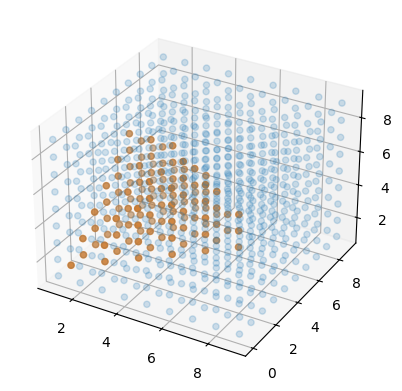

In [100]:
import matplotlib.pyplot as plt
import math

limit_r = 9



limit = 10
test0 =[[i,j,k] 
        for i in range(1,limit) 
        for j in range(0,limit) 
        for k in range(1,limit) 
        ] 
test1 =[[i,j,k] 
        for i in range(1,limit) 
        for j in range(0,limit) 
        for k in range(1,limit) 
        if math.sqrt(i**2+j**2+k**2) <= limit_r 
        if (math.acos(k/math.sqrt(i**2+j**2+k**2))>= math.pi/4 and theta <= 3*math.pi/4) 
        if (math.copysign(math.acos(i/(math.sqrt(i**2+j**2))),j) >= math.pi/4 and phi <= 5*math.pi/4)
        ] 

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 0.2)

xs, ys, zs = [list(x) for x in zip(*test1)]
ax.scatter(xs,ys,zs)

In [98]:
import matplotlib.pyplot as plt
import numpy as np

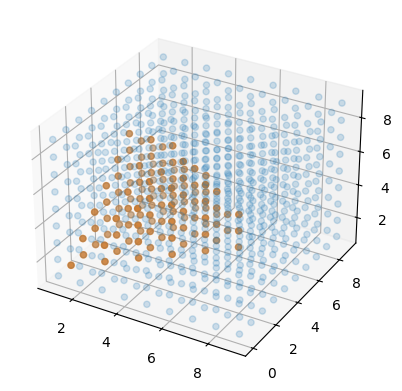

In [99]:

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 0.2)

xs, ys, zs = [list(x) for x in zip(*test1)]
ax.scatter(xs,ys,zs)

In [ ]:
import matplotlib.pyplot as plt
import math

limit_r = 40



limit = 50
test0 =[[i,j,k] 
        for i in range(1,limit) 
        for j in range(0,limit) 
        for k in range(1,limit) 
        ] 
test1 =[[i,j,k] 
        for i in range(1,limit) 
        for j in range(0,limit) 
        for k in range(1,limit) 
        if math.sqrt(i**2+j**2+k**2) <= limit_r 
        if (math.acos(k/math.sqrt(i**2+j**2+k**2))>= math.pi/4 and math.acos(k/math.sqrt(i**2+j**2+k**2)) <= 3*math.pi/4) 
        if (math.copysign(math.acos(i/(math.sqrt(i**2+j**2))),j) >= math.pi/4 and math.copysign(math.acos(i/(math.sqrt(i**2+j**2))),j) <= 5*math.pi/4)
        ] 

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 0.001)

xs, ys, zs = [list(x) for x in zip(*test1)]
ax.scatter(xs,ys,zs)
plt.show()

# 2. Versuch einen Kegel zu machen

In [ ]:
import matplotlib.pyplot as plt
import math

limit_r = 20

Offset_i, Offset_j, Offset_k = 35,35,35

limit = 75

test0 =[[i,j,k] 
        for i in range(0,limit) 
        for j in range(0,limit) 
        for k in range(0,limit) 
        ] 
test1 =[[i,j+Offset_j,k+Offset_k] 
        for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r + Offset_i
        if j**2 + k**2 <= i**2
        ] 

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

#xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
#ax.scatter(xs0,ys0,zs0, alpha = 0.00)

xs, ys, zs = [list(x) for x in zip(*test1)]
ax.scatter(xs,ys,zs)
plt.show()

In [ ]:
i <= limit_r
j**2 + k**2 <= i**2

In [101]:
test3 = np.random.rand(3,3,3)
print(test3)

[[[0.49646989 0.80107855 0.50962783]
  [0.48381798 0.81534443 0.05494601]
  [0.33772068 0.88375914 0.71537077]]

 [[0.06920025 0.14412707 0.10510521]
  [0.23943053 0.90507013 0.08385857]
  [0.71589996 0.90768752 0.11220496]]

 [[0.95440689 0.2672457  0.2537464 ]
  [0.1676427  0.67245855 0.61795853]
  [0.70783959 0.54198574 0.41689729]]]


In [102]:
test3[0,0,0]

0.49646989429284316

In [111]:
list_index =[[0,0,0],[1,1,1]]
for index in list_index:
    i,j,k = index
    print(test3[i,j,k]) 

0.49646989429284316
0.9050701254078576


In [104]:
list_index[0]

[0, 0, 0]

In [112]:
from matplotlib import cm

x = np.linspace(-10,10,num=100)
y = np.linspace(-10,10,num=100)

x,y = np.meshgrid(x,y)
z = np.exp(-0.1*x**2-0.1*y**2)

fig = plt.figure()
ax = fig.add_subplot(111,projetion="3d")
ax.plot_surface(x,y,z, cmap = cm.jet)
plt.show()

<Axes3D: >

<Figure size 640x480 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
import math

limit_r = 20

Offset_i, Offset_j, Offset_k = 35,35,35

limit = 75

test0 =[[i,j,k] 
        for i in range(0,limit) 
        for j in range(0,limit) 
        for k in range(0,limit) 
        ] 
test1 =[[i,j+Offset_j,k+Offset_k] 
        for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r + Offset_i
        if j**2 + k**2 <= i**2
        ] 

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

#xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
#ax.scatter(xs0,ys0,zs0, alpha = 0.00)

xs, ys, zs = [list(x) for x in zip(*test1)]
ax.scatter(xs,ys,zs)
plt.show()

In [115]:
np.exp(-30**2)

0.0

In [125]:
def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))

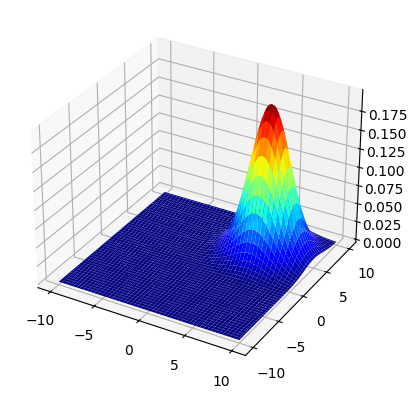

In [133]:
from matplotlib import cm

x = np.linspace(-10,10,num=100)
y = np.linspace(-10,10,num=100)

x,y = np.meshgrid(x,y)
# z = gauss_3d(x,y)
fig = plt.figure()
ax = fig.add_subplot(projection="3d")
ax.plot_surface(x,y,gauss_3d(x,y,mu_x=5,mu_y=5), cmap = cm.jet)
plt.show()

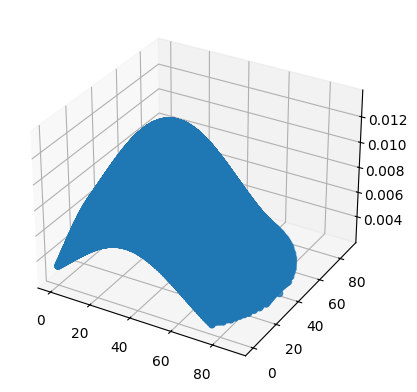

In [142]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))

# Länge des Kegels
limit_r = 20
# Offset des Kegels in x-Richtung
Offset_i, Offset_j, Offset_k = 35,35,35
# Größe der N**3 Matrix
limit = 75
# Gesamte anzahl der Koordinaten
test0 =[[i,j,k] 
        for i in range(0,limit) 
        for j in range(0,limit) 
        for k in range(0,limit) 
        ] 
# Nur Koordinaten innerhalb des Kegels mit offset und entlang der x-Achse
test1 =[[i,j+Offset_j,k+Offset_k] 
        for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r + Offset_i
        if j**2 + k**2 <= i**2
        ] 

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

#xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
#ax.scatter(xs0,ys0,zs0, alpha = 0.00)

# Plot der Punkte im Kegel
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
# ax.scatter(xs,ys,zs)

x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
ax.scatter(ys,zs,x_gauss)

plt.show()

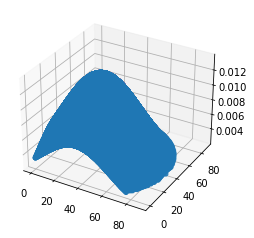

In [21]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))

# Länge des Kegels
limit_r = 20
# Offset des Kegels in x-Richtung
Offset_i, Offset_j, Offset_k = 35,35,35
# Größe der N**3 Matrix
limit = 75
# Gesamte anzahl der Koordinaten
test0 =[[i,j,k] 
        for i in range(0,limit) 
        for j in range(0,limit) 
        for k in range(0,limit) 
        ] 
# Nur Koordinaten innerhalb des Kegels mit offset und entlang der x-Achse
test1 =[[i,j+Offset_j,k+Offset_k] 
        for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r + Offset_i
        if j**2 + k**2 <= i**2
        ] 

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

#xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
#ax.scatter(xs0,ys0,zs0, alpha = 0.00)

# Plot der Punkte im Kegel
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
# ax.scatter(xs,ys,zs)

x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
ax.scatter(ys,zs,x_gauss)

plt.show()

In [1]:
alpha, beta = math.pi/2, math.pi/2
i = (np.cos(beta)(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
j = (np.sin(beta)(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
k = (np.cos(alpha)*k-np.sin(alpha)*i)

NameError: name 'math' is not defined

7570 7570 7570


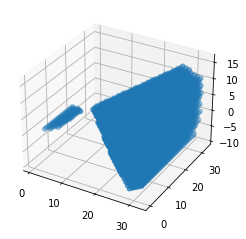

In [38]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))

# Länge des Kegels
limit_r = 10
# Offset des Kegels in x-Richtung
Offset_i, Offset_j, Offset_k = 12,12,12
# alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
alpha, beta = math.pi/5, math.pi/10
# Größe der N**3 Matrix
limit = 25
# Gesamte anzahl der Koordinaten
test0 =[[i,j,k] 
        for i in range(0,limit) 
        for j in range(0,limit) 
        for k in range(0,limit) 
        ] 
# Nur Koordinaten innerhalb des Kegels mit offset und entlang der x-Achse
# if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r + Offset_i
# if (np.sin(beta)*(np.cos(beta)*i+np.sin(beta)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        
# [i,j,k] 

test1 =[[(np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*(k+Offset_k))-np.sin(beta)*(j+Offset_j)),
         (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*(k+Offset_k))+np.cos(beta)*(j+Offset_j)),
         (np.cos(alpha)*(k+Offset_k)-np.sin(alpha)*i)
         ] 
        for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r + Offset_i
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        ] 

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

# xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
# ax.scatter(xs0,ys0,zs0, alpha = 0.01)

# Plot der Punkte im Kegel
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
print(len(xs), len(ys), len(zs))
ax.scatter(xs,ys,zs)


# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

7570 7570 7570


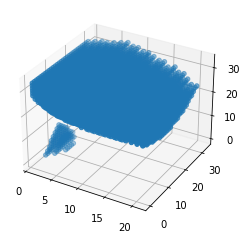

In [36]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))

# Länge des Kegels
limit_r = 10
# Offset des Kegels in x-Richtung
Offset_i, Offset_j, Offset_k = 12,12,12
# alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
alpha, beta = math.pi/3, 0
# Größe der N**3 Matrix
limit = 25
# Gesamte anzahl der Koordinaten
test0 =[[i,j,k] 
        for i in range(0,limit) 
        for j in range(0,limit) 
        for k in range(0,limit) 
        ] 
# Nur Koordinaten innerhalb des Kegels mit offset und entlang der x-Achse
# if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r + Offset_i
# if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        
# [i,j,k] 

test1 =[[i,j+Offset_j,k+Offset_k] 
        for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r + Offset_i
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        ] 

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

# xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
# ax.scatter(xs0,ys0,zs0, alpha = 0.01)

# Plot der Punkte im Kegel
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
print(len(xs), len(ys), len(zs))
ax.scatter(xs,ys,zs)


# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
# ax.scatter(ys,zs,x_gauss)

plt.show()

In [ ]:
from matplotlib import cm
import numpy as np
import matplotlib.pyplot as plt

x = np.linspace(-10,10,num=100)
y = np.linspace(-10,10,num=100)

x,y = np.meshgrid(x,y)
z = np.exp(-0.1*x**2-0.1*y**2)

fig = plt.figure()
ax = fig.add_subplot(projection="3d")
ax.plot_surface(x,y,z, cmap = cm.jet)
plt.show()

6080 6080 6080


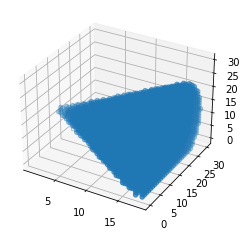

In [39]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))
def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # alpha, beta = math.pi/5, math.pi/10
    # Größe der N**3 Matrix
    # limit = 25
    # Gesamte anzahl der Koordinaten
    # test0 =[[i,j,k] 
    #         for i in range(0,limit) 
    #         for j in range(0,limit) 
    #         for k in range(0,limit) 
    #         ] 
    # Nur Koordinaten innerhalb des Kegels mit offset und entlang der x-Achse
    # if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r + Offset_i
    # if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
            
    # [i,j,k] 

    _test1 =[[(np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*(k+Offset_k))-np.sin(beta)*(j+Offset_j)),
            (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*(k+Offset_k))+np.cos(beta)*(j+Offset_j)),
            (np.cos(alpha)*(k+Offset_k)-np.sin(alpha)*i)
            ] 
            for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
            for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
            for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
            if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r + Offset_i
            if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
            ] 
    return _test1

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

# xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
# ax.scatter(xs0,ys0,zs0, alpha = 0.01)

# Plot der Punkte im Kegel
test1 = indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0)
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
print(len(xs), len(ys), len(zs))
ax.scatter(xs,ys,zs)


# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

6080 6080 6080


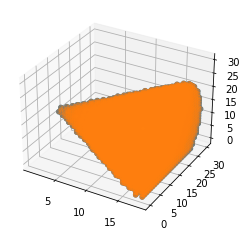

In [41]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))
def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
  
    _test1 =[[(np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*(k+Offset_k))-np.sin(beta)*(j+Offset_j)),
            (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*(k+Offset_k))+np.cos(beta)*(j+Offset_j)),
            (np.cos(alpha)*(k+Offset_k)-np.sin(alpha)*i)
            ] 
            for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
            for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
            for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
            if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r + Offset_i
            if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
            ] 

    _test2 =[[i,j+Offset_j,k+Offset_k] 
        for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r + Offset_i
        if j**2 + k**2 <= i**2
        ] 
    return _test1, _test2

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
 


# Plot der Punkte im Kegel
test0, test1 = indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0)
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 1)
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
print(len(xs), len(ys), len(zs))
ax.scatter(xs,ys,zs)


# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

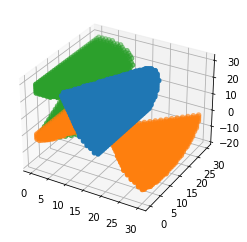

In [43]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
  
    _test1 =[[(np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*(k+Offset_k))-np.sin(beta)*(j+Offset_j)),
            (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*(k+Offset_k))+np.cos(beta)*(j+Offset_j)),
            (np.cos(alpha)*(k+Offset_k)-np.sin(alpha)*i)
            ] 
            for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
            for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
            for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
            if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r + Offset_i
            if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
            ] 

    _test0 =[[i,j+Offset_j,k+Offset_k] 
        for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r + Offset_i
        if j**2 + k**2 <= i**2
        ] 
    
    _test2 =[[i,j+Offset_j,k+Offset_k] 
        for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r + Offset_i
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        ] 
    
    return _test0, _test1, _test2

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
 


# Plot der Punkte im Kegel
test0, test1, test2 = indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=math.pi/2, beta=0)
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 1)
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
ax.scatter(xs,ys,zs)
xs2, ys2, zs2 = [list(x) for x in zip(*test2)]
xs2, ys2, zs2 = np.array(xs2),np.array(ys2),np.array(zs2)
ax.scatter(xs2,ys2,zs2)


# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

In [44]:
# test2 ist richtig was die position und richtung des Kegels angeht.
# es fällt aber auf das die lösung mit der ersten Implementierung des nicht Rotierbaren Kegels 
#       x >= 0
# Falsch ist, und stattdessen eine andere Logikabfrage notwendig ist
#       normalvektor * vektor der gedrehten ijk >= 0 

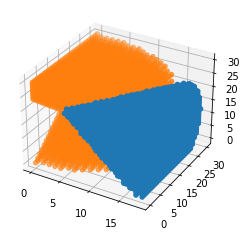

In [47]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)

    _test0 =[[i,j+Offset_j,k+Offset_k] 
        for i in range(1, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r + Offset_i
        if j**2 + k**2 <= i**2
        ] 
    
    _test1 =[[i,j+Offset_j,k+Offset_k] 
        for i in range(-Offset_i, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r + Offset_i
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)*np.cos(alpha)*np.cos(beta) + (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)*np.cos(alpha)*np.sin(beta) - (np.cos(alpha)*k-np.sin(alpha)*i)*np.sin(alpha) >= 0
        ] 
    
    return _test0, _test1

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
 


# Plot der Punkte im Kegel
test0, test1 = indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=math.pi/2, beta=0)
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 1)
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
ax.scatter(xs,ys,zs)



# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

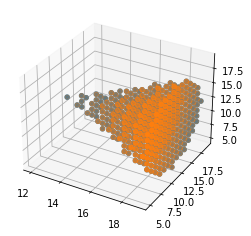

In [48]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)

    _test0 =[[i+Offset_i,j+Offset_j,k+Offset_k]  
        for i in range(-limit_r if -limit_r < -Offset_i else -Offset_i, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-limit_r if -limit_r < -Offset_j else -Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-limit_r if -limit_r < -Offset_k else -Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r
        if j**2 + k**2 <= i**2
        if i >= 0
        ] 
    
    _test1 =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if -limit_r < -Offset_i else -Offset_i, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-limit_r if -limit_r < -Offset_j else -Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-limit_r if -limit_r < -Offset_k else -Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)*np.cos(alpha)*np.cos(beta) + (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)*np.cos(alpha)*np.sin(beta) - (np.cos(alpha)*k-np.sin(alpha)*i)*np.sin(alpha) >= 0
        ] 
    
    return _test0, _test1

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
 


# Plot der Punkte im Kegel
test0, test1 = indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0)
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 1)
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
ax.scatter(xs,ys,zs)



# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

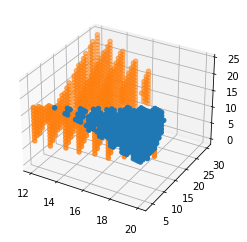

In [49]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)

    _test0 =[[i+Offset_i,j+Offset_j,k+Offset_k]  
        for i in range(-limit_r if -limit_r < -Offset_i else -Offset_i, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-limit_r if -limit_r < -Offset_j else -Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-limit_r if -limit_r < -Offset_k else -Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r
        if j**2 + k**2 <= i**2
        if i >= 0
        ] 
    
    _test1 =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if -limit_r < -Offset_i else -Offset_i, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-limit_r if -limit_r < -Offset_j else -Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-limit_r if -limit_r < -Offset_k else -Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)*np.cos(alpha)*np.cos(beta) + (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)*np.cos(alpha)*np.sin(beta) - (np.cos(alpha)*k-np.sin(alpha)*i)*np.sin(alpha) >= 0
        ] 
    
    return _test0, _test1

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
 


# Plot der Punkte im Kegel
test0, test1 = indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=math.pi/3)
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 1)
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
ax.scatter(xs,ys,zs)



# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

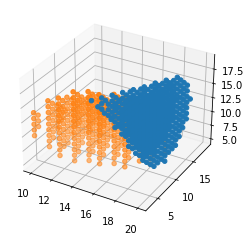

In [50]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)

    _test0 =[[i+Offset_i,j+Offset_j,k+Offset_k]  
        for i in range(-limit_r if -limit_r < -Offset_i else -Offset_i, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-limit_r if -limit_r < -Offset_j else -Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-limit_r if -limit_r < -Offset_k else -Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r
        if j**2 + k**2 <= i**2
        if i >= 0
        ] 
    
    _test1 =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if -limit_r < -Offset_i else -Offset_i, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-limit_r if -limit_r < -Offset_j else -Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-limit_r if -limit_r < -Offset_k else -Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) >= 0
        ] 
    
    return _test0, _test1

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
 


# Plot der Punkte im Kegel
test0, test1 = indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=math.pi/3)
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 1)
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
ax.scatter(xs,ys,zs)



# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

In [51]:
# Es fällt auf das die kegel nich vollstänfig sind.
# Also das sie nicht den gesamten raum ausnutzen den sie haben sollten (limit_r**3)

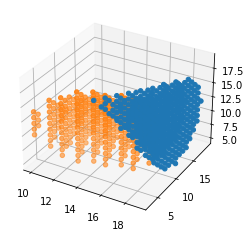

In [52]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)

    _test0 =[[i+Offset_i,j+Offset_j,k+Offset_k]  
        for i in range(-limit_r if -limit_r < -Offset_i else -Offset_i, Offset_i + limit_r if Offset_i + limit_r < limit else limit) 
        for j in range(-limit_r if -limit_r < -Offset_j else -Offset_j, Offset_j + limit_r if Offset_j + limit_r < limit else limit) 
        for k in range(-limit_r if -limit_r < -Offset_k else -Offset_k, Offset_k + limit_r if Offset_k + limit_r < limit else limit) 
        if i <= limit_r
        if j**2 + k**2 <= i**2
        if i >= 0
        ] 
    
    _test1 =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if -limit_r < -Offset_i else -Offset_i, limit_r if limit_r < limit else limit) 
        for j in range(-limit_r if -limit_r < -Offset_j else -Offset_j, limit_r if limit_r < limit else limit) 
        for k in range(-limit_r if -limit_r < -Offset_k else -Offset_k, limit_r if limit_r < limit else limit) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) >= 0
        ] 
    
    return _test0, _test1

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
 


# Plot der Punkte im Kegel
test0, test1 = indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=math.pi/3)
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 1)
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
ax.scatter(xs,ys,zs)



# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

In [ ]:
# die zugelassenen ijk waren zu klein 

In [ ]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)

    _test0 =[[i+Offset_i,j+Offset_j,k+Offset_k]  
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if i <= limit_r
        if j**2 + k**2 <= i**2
        if i >= 0
        ] 
    
    _test1 =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) >= 0
        ] 
    
    return _test0, _test1

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
 


# Plot der Punkte im Kegel
test0, test1 = indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=7, alpha=0, beta=math.pi/2)
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 1)
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
ax.scatter(xs,ys,zs)



# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

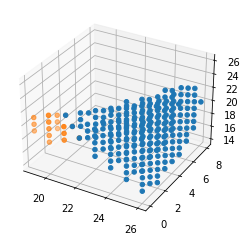

In [53]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)

    _test0 =[[i+Offset_i,j+Offset_j,k+Offset_k]  
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if i <= limit_r
        if j**2 + k**2 <= i**2
        if i >= 0
        ] 
    
    _test1 =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) >= 0
        ] 
    
    return _test0, _test1

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
 


# Plot der Punkte im Kegel
test0, test1 = indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=2, Offset_k=20, limit_r=7, alpha=0, beta=math.pi/2)
xs0, ys0, zs0 = [list(x) for x in zip(*test0)]
ax.scatter(xs0,ys0,zs0, alpha = 1)
xs, ys, zs = [list(x) for x in zip(*test1)]
xs, ys, zs = np.array(xs),np.array(ys),np.array(zs)
ax.scatter(xs,ys,zs)



# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

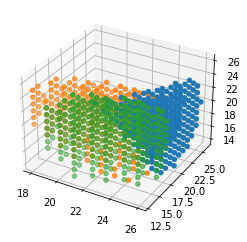

In [3]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))


def indizes_des_Kegels_x(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7):
    _test0 =[[i+Offset_i,j+Offset_j,k+Offset_k]  
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if i <= limit_r
        if j**2 + k**2 <= i**2
        if i >= 0
        ] 
    return _test0


def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) >= 0
        ] 
    
    return _Index_lst_im_Kegel

fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
 


# Plot der Punkte im Kegel
indizes_des_ges_Raumes_lst = indizes_des_Kegels_x(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=7)
xs0, ys0, zs0 = [list(x) for x in zip(*indizes_des_ges_Raumes_lst)]
ax.scatter(xs0,ys0,zs0, alpha = 1)

indizes_des_Kegels_lst_1 = indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=7, alpha=math.pi/5, beta=math.pi/3)
xs1, ys1, zs1 = [list(x) for x in zip(*indizes_des_Kegels_lst_1)]
ax.scatter(xs1,ys1,zs1)

indizes_des_Kegels_lst_2 = indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=7, alpha=0, beta=math.pi/3)
xs2, ys2, zs2 = [list(x) for x in zip(*indizes_des_Kegels_lst_2)]
ax.scatter(xs2,ys2,zs2)



# x_gauss = gauss_3d(ys,zs,mu_x=Offset_j,mu_y=Offset_k, sigma=30)
#ax.scatter(ys,zs,x_gauss)

plt.show()

In [ ]:
# der Winkel beta ist aus dem Intervall (-pi/2, +pi/2)
# alpha aus dem Intervall (-pi, +pi)

# Test 1 kontinuierliche Rotation

37


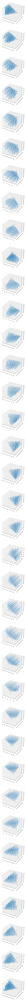

In [14]:
import matplotlib.pyplot as plt
import math
import numpy as np


def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))


def indizes_des_Kegels_x(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7):
    _test0 =[[i+Offset_i,j+Offset_j,k+Offset_k]  
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if i <= limit_r
        if j**2 + k**2 <= i**2
        if i >= 0
        ] 
    return _test0


def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) >= 0
        ] 
    
    return _Index_lst_im_Kegel

fig, ax = plt.subplots(nrows=37,ncols=1, figsize=(20,200), subplot_kw=dict(projection="3d"))
 
lst_winkel = [i*math.pi/180 for i in range(0,370, 10)]
print(len(lst_winkel))

# Plot der Punkte im Kegel
for i, row in enumerate(ax):
    indizes_des_Kegels_lst_1 = indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=7, alpha=lst_winkel[i], beta=math.pi)
    xs1, ys1, zs1 = [list(x) for x in zip(*indizes_des_Kegels_lst_1)]
    row.azim, row.dist, row.elev = -60, 10, 30
    row.scatter(xs1, ys1, zs1)
        
plt.show()

In [17]:
lst_winkel = [i*math.pi/180 for i in range(0,360, 10)]
print(lst_winkel)
for i, winkel in enumerate(lst_winkel):
    print(i , winkel)

[0.0, 0.17453292519943295, 0.3490658503988659, 0.5235987755982988, 0.6981317007977318, 0.8726646259971648, 1.0471975511965976, 1.2217304763960306, 1.3962634015954636, 1.5707963267948966, 1.7453292519943295, 1.9198621771937625, 2.0943951023931953, 2.2689280275926285, 2.443460952792061, 2.6179938779914944, 2.792526803190927, 2.9670597283903604, 3.141592653589793, 3.3161255787892263, 3.490658503988659, 3.6651914291880923, 3.839724354387525, 4.014257279586958, 4.1887902047863905, 4.363323129985823, 4.537856055185257, 4.71238898038469, 4.886921905584122, 5.061454830783555, 5.235987755982989, 5.410520681182422, 5.585053606381854, 5.759586531581287, 5.934119456780721, 6.108652381980153]
0 0.0
1 0.17453292519943295
2 0.3490658503988659
3 0.5235987755982988
4 0.6981317007977318
5 0.8726646259971648
6 1.0471975511965976
7 1.2217304763960306
8 1.3962634015954636
9 1.5707963267948966
10 1.7453292519943295
11 1.9198621771937625
12 2.0943951023931953
13 2.2689280275926285
14 2.443460952792061
15 2.6

In [68]:
i_rot = lambda alpha, beta : (np.cos(beta)*(np.cos(alpha)))
j_rot = lambda alpha, beta : (np.sin(beta)*(np.cos(alpha)))
k_rot = lambda alpha, beta : (-np.sin(alpha))

In [69]:
lst_winkel = [i*math.pi/180 for i in range(0,370, 10)]
lst_alpha = [[i_rot(alpha, beta), j_rot(alpha, beta), k_rot(alpha, beta)] for alpha in lst_winkel for beta in lst_winkel]

In [70]:
def has_duplicates(seq):
    seen = []
    unique_lst = [x for x in seq if x not in seen and not seen.append(x)]
    return len(seq), len(unique_lst)

In [71]:
print(has_duplicates(lst_alpha))

(1369, 1363)


In [ ]:
# es ergeben sich 6 duplikate 

In [ ]:
lst_winkel = [i*math.pi/180 for i in range(0,370, 10)]
lst_alpha = [[i_rot(alpha, beta), j_rot(alpha, beta), k_rot(alpha, beta)] for alpha in lst_winkel for beta in lst_winkel]

In [8]:

i_rot = lambda alpha, beta : (np.cos(beta)*(np.cos(alpha)))
j_rot = lambda alpha, beta : (np.sin(beta)*(np.cos(alpha)))
k_rot = lambda alpha, beta : (-np.sin(alpha))

lst_winkel_aplha = [i*math.pi/180 for i in range(0,360, 1)]
lst_winkel_beta = [i*math.pi/180 for i in range(-90,90, 1)]
lst_alpha = [[i_rot(alpha, beta), j_rot(alpha, beta), k_rot(alpha, beta)] for alpha in lst_winkel_aplha for beta in lst_winkel_beta]

def has_duplicates(seq):
    seen = []
    unique_lst = [x for x in seq if x not in seen and not seen.append(x)]
    return len(seq), len(unique_lst)

rounded_lst_alpha = [[round(i[0],5),round(i[1],5),round(i[2],5)] for i in lst_alpha]
print(has_duplicates(rounded_lst_alpha))
# print(rounded_lst_alpha)

(64800, 64442)


In [86]:
64800-64442

358

In [56]:
i_rot = lambda alpha, beta : (np.cos(beta)*(np.cos(alpha)))
j_rot = lambda alpha, beta : (np.sin(beta)*(np.cos(alpha)))
k_rot = lambda alpha, beta : (-np.sin(alpha))
i_rot_pi2 = lambda beta : (i_rot(alpha = math.pi/2, beta = beta))
j_rot_pi2 = lambda beta : (j_rot(alpha = math.pi/2, beta = beta))
k_rot_pi2 = lambda beta : (k_rot(alpha = math.pi/2, beta = beta))

lst_winkel = [i*math.pi/180 for i in range(0,370, 10)]
lst_alpha = [[i_rot_pi2(beta), j_rot_pi2(beta), k_rot_pi2(beta)] for beta in lst_winkel]


def has_duplicates(seq):
    seen = []
    unique_lst = [x for x in seq if x not in seen and not seen.append(x)]
    return len(seq), len(unique_lst)

print(has_duplicates(lst_alpha))
print(lst_alpha)

(37, 37)
[[6.123233995736766e-17, 0.0, -1.0], [6.030208312509488e-17, 1.0632884247878856e-17, -1.0], [5.753957801139251e-17, 2.094269368838496e-17, -1.0], [5.3028761936245346e-17, 3.0616169978683824e-17, -1.0], [4.6906693763513654e-17, 3.9359389436709925e-17, -1.0], [3.935938943670993e-17, 4.6906693763513654e-17, -1.0], [3.0616169978683836e-17, 5.302876193624534e-17, -1.0], [2.0942693688384965e-17, 5.753957801139251e-17, -1.0], [1.0632884247878861e-17, 6.030208312509488e-17, -1.0], [3.749399456654644e-33, 6.123233995736766e-17, -1.0], [-1.0632884247878855e-17, 6.030208312509488e-17, -1.0], [-2.094269368838496e-17, 5.753957801139251e-17, -1.0], [-3.061616997868382e-17, 5.3028761936245346e-17, -1.0], [-3.935938943670993e-17, 4.6906693763513654e-17, -1.0], [-4.690669376351365e-17, 3.935938943670994e-17, -1.0], [-5.3028761936245346e-17, 3.0616169978683824e-17, -1.0], [-5.753957801139251e-17, 2.0942693688384968e-17, -1.0], [-6.030208312509488e-17, 1.0632884247878853e-17, -1.0], [-6.12323399

In [63]:
rounded_lst_alpha = [[round(i[0],5),round(i[1],5),round(i[2],5)] for i in lst_alpha]

In [65]:
print(rounded_lst_alpha)


[[0.0, 0.0, -1.0], [0.0, 0.0, -1.0], [0.0, 0.0, -1.0], [0.0, 0.0, -1.0], [0.0, 0.0, -1.0], [0.0, 0.0, -1.0], [0.0, 0.0, -1.0], [0.0, 0.0, -1.0], [0.0, 0.0, -1.0], [0.0, 0.0, -1.0], [-0.0, 0.0, -1.0], [-0.0, 0.0, -1.0], [-0.0, 0.0, -1.0], [-0.0, 0.0, -1.0], [-0.0, 0.0, -1.0], [-0.0, 0.0, -1.0], [-0.0, 0.0, -1.0], [-0.0, 0.0, -1.0], [-0.0, 0.0, -1.0], [-0.0, -0.0, -1.0], [-0.0, -0.0, -1.0], [-0.0, -0.0, -1.0], [-0.0, -0.0, -1.0], [-0.0, -0.0, -1.0], [-0.0, -0.0, -1.0], [-0.0, -0.0, -1.0], [-0.0, -0.0, -1.0], [-0.0, -0.0, -1.0], [0.0, -0.0, -1.0], [0.0, -0.0, -1.0], [0.0, -0.0, -1.0], [0.0, -0.0, -1.0], [0.0, -0.0, -1.0], [0.0, -0.0, -1.0], [0.0, -0.0, -1.0], [0.0, -0.0, -1.0], [0.0, -0.0, -1.0]]


In [66]:
print(has_duplicates(rounded_lst_alpha))

(37, 1)


In [5]:
# es exestieren Duplikate, welche sind dieses?

In [10]:

i_rot = lambda alpha, beta : (np.cos(beta)*(np.cos(alpha)))
j_rot = lambda alpha, beta : (np.sin(beta)*(np.cos(alpha)))
k_rot = lambda alpha, beta : (-np.sin(alpha))

lst_winkel_aplha = [i*math.pi/180 for i in range(0,360, 1)]
lst_winkel_beta = [i*math.pi/180 for i in range(-90,90, 1)]
lst_alpha = [[i_rot(alpha, beta), j_rot(alpha, beta), k_rot(alpha, beta)] for alpha in lst_winkel_aplha for beta in lst_winkel_beta]

def has_duplicates(seq):
    seen = []
    duplicates = []
    unique_lst = [x for x in seq if x not in seen and not seen.append(x) and not duplicates.append(x)]
    return len(seq), len(unique_lst), duplicates

rounded_lst_alpha = [[round(i[0],5),round(i[1],5),round(i[2],5)] for i in lst_alpha]
len_seq, len_seq_nd, lst_duplicates = has_duplicates(rounded_lst_alpha)
print(len_seq, len_seq_nd)
# print(rounded_lst_alpha)

64800 64442


In [11]:
len(lst_duplicates)

64442

In [12]:
# Laufzeit optimierung

In [25]:
import matplotlib.pyplot as plt
import math
import numpy as np
import time



def gauss_3d(x,y,mu_x=0,mu_y=0,sigma=2):
    return 1/(np.sqrt(math.pi*2)*sigma)*np.exp(-1/2*(((x-mu_x)/sigma)**2+((y-mu_y)/sigma)**2))


def indizes_des_Kegels_x(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7):
    _test0 =[[i+Offset_i,j+Offset_j,k+Offset_k]  
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if i <= limit_r
        if j**2 + k**2 <= i**2
        if i >= 0
        ] 
    return _test0


def indizes_des_Kegels0(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) <= limit_r
        if (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)**2 + (np.cos(alpha)*k-np.sin(alpha)*i)**2 <= (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)**2
        if (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j) >= 0
        ] 
    
    return _Index_lst_im_Kegel


def indizes_des_Kegels1(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) <= limit_r
        if (sin_beta*(cos_alpha*i+sin_alpha*k)+cos_beta*j)**2 + (cos_alpha*k-sin_alpha*i)**2 <= (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j)**2
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) >= 0
        ] 
    
    return _Index_lst_im_Kegel

# fig, ax = plt.subplots(nrows=37,ncols=1, figsize=(20,200), subplot_kw=dict(projection="3d"))
 
lst_winkel = [i*math.pi/180 for i in range(0, 360, 1)]
# print(len(lst_winkel))

# Plot der Punkte im Kegel
start_time0 = time.time()

for i in range(0, 360):
    indizes_des_Kegels_lst_1 = indizes_des_Kegels0(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=7, alpha=lst_winkel[i], beta=math.pi/3)
    # xs1, ys1, zs1 = [list(x) for x in zip(*indizes_des_Kegels_lst_1)]
    # row.azim, row.dist, row.elev = -60, 10, 30
    # row.scatter(xs1, ys1, zs1)

duration0 = time.time() - start_time0

start_time1 = time.time()

for i in range(0, 360):
    indizes_des_Kegels_lst_0 = indizes_des_Kegels1(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=7, alpha=lst_winkel[i], beta=math.pi/3)
    # xs1, ys1, zs1 = [list(x) for x in zip(*indizes_des_Kegels_lst_1)]
    # row.azim, row.dist, row.elev = -60, 10, 30
    # row.scatter(xs1, ys1, zs1)
    
duration1 = time.time() - start_time1

print(duration0, duration1)
        
# plt.show()

8.656099319458008 1.121436595916748


In [ ]:
# es ist sehr gut erkennbar das die Funktion indizes_des_Kegels1 deutlich schneller ist als die vorherige version

In [16]:
import math
import numpy as np


def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) <= limit_r
        if (sin_beta*(cos_alpha*i+sin_alpha*k)+cos_beta*j)**2 + (cos_alpha*k-sin_alpha*i)**2 <= (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j)**2
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) >= 0
        ] 
    
    return _Index_lst_im_Kegel


def has_duplicates(seq):
    duplicates = [i for i in seq if seq.count(i) > 1]
    #unique_lst = [i for i in seq if seq.count(i) == 1]
    #unique_lst, 
    return duplicates

indizes_des_Kegels_lst = []
lst_winkel = [i*math.pi/180 for i in range(0, 360, 5)]

for i in range(0, 72):
    for j in range(0, 72):
        indizes_des_Kegels_lst += (indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=3, alpha=lst_winkel[i], beta=lst_winkel[j]))
    

print(indizes_des_Kegels_lst)

[[20, 20, 20], [21, 19, 20], [21, 20, 19], [21, 20, 20], [21, 20, 21], [21, 21, 20], [22, 18, 20], [22, 19, 19], [22, 19, 20], [22, 19, 21], [22, 20, 18], [22, 20, 19], [22, 20, 20], [22, 20, 21], [22, 20, 22], [22, 21, 19], [22, 21, 20], [22, 21, 21], [22, 22, 20], [20, 20, 20], [21, 19, 20], [21, 20, 20], [22, 18, 19], [22, 18, 20], [22, 18, 21], [22, 19, 19], [22, 19, 20], [22, 19, 21], [22, 20, 19], [22, 20, 20], [22, 20, 21], [22, 21, 19], [22, 21, 20], [22, 21, 21], [20, 20, 20], [21, 19, 20], [21, 20, 20], [22, 18, 19], [22, 18, 20], [22, 18, 21], [22, 19, 18], [22, 19, 19], [22, 19, 20], [22, 19, 21], [22, 19, 22], [22, 20, 19], [22, 20, 20], [22, 20, 21], [22, 21, 19], [22, 21, 20], [22, 21, 21], [20, 20, 20], [21, 19, 20], [21, 20, 20], [22, 17, 19], [22, 17, 20], [22, 17, 21], [22, 18, 19], [22, 18, 20], [22, 18, 21], [22, 19, 18], [22, 19, 19], [22, 19, 20], [22, 19, 21], [22, 19, 22], [22, 20, 19], [22, 20, 20], [22, 20, 21], [22, 21, 20], [20, 20, 20], [21, 18, 20], [21, 

In [17]:
print(len(indizes_des_Kegels_lst))
rounded_lst_Kegel = [[round(i[0],5),round(i[1],5),round(i[2],5)] for i in indizes_des_Kegels_lst]
print(len(rounded_lst_Kegel))
print(rounded_lst_Kegel[0])

123317
123317
[20, 20, 20]


In [18]:
lst_duplicates = has_duplicates(rounded_lst_Kegel)

In [28]:
print(len(lst_duplicates))

123317


In [31]:
dict_duplicates = {}
for lst_for in rounded_lst_Kegel:
    if dict_duplicates.get(str(lst_for)) == None:
        dict_duplicates.update({str(lst_for):1})
    else:
        dict_duplicates[str(lst_for)] += 1

In [33]:
sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])

In [34]:
sorted_dict_duplicates

[('[17, 20, 17]', 2),
 ('[18, 18, 17]', 42),
 ('[17, 18, 22]', 42),
 ('[17, 22, 22]', 43),
 ('[17, 18, 18]', 43),
 ('[18, 22, 17]', 43),
 ('[22, 18, 17]', 43),
 ('[17, 22, 18]', 44),
 ('[22, 22, 17]', 44),
 ('[17, 17, 20]', 59),
 ('[20, 17, 17]', 59),
 ('[18, 17, 18]', 132),
 ('[18, 17, 22]', 132),
 ('[22, 17, 18]', 132),
 ('[22, 17, 22]', 132),
 ('[17, 19, 22]', 183),
 ('[17, 21, 22]', 183),
 ('[18, 19, 17]', 183),
 ('[18, 21, 17]', 183),
 ('[17, 19, 18]', 184),
 ('[17, 21, 18]', 184),
 ('[22, 19, 17]', 184),
 ('[22, 21, 17]', 184),
 ('[17, 18, 19]', 233),
 ('[17, 18, 21]', 233),
 ('[17, 20, 22]', 233),
 ('[19, 18, 17]', 233),
 ('[18, 20, 17]', 233),
 ('[21, 18, 17]', 233),
 ('[17, 20, 18]', 234),
 ('[17, 22, 19]', 234),
 ('[17, 22, 21]', 234),
 ('[19, 22, 17]', 234),
 ('[21, 22, 17]', 234),
 ('[22, 20, 17]', 234),
 ('[17, 18, 20]', 305),
 ('[20, 18, 17]', 305),
 ('[17, 22, 20]', 306),
 ('[20, 22, 17]', 306),
 ('[22, 22, 22]', 386),
 ('[18, 22, 18]', 387),
 ('[22, 22, 18]', 387),
 ('[

# Test 2 Kontinuierliche Rotation

37


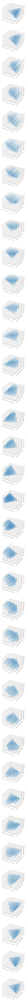

In [4]:
import numpy as np
import matplotlib.pylab as plt
import math

def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r if limit_r < Offset_i else -Offset_i, limit_r if limit_r < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r if limit_r < Offset_j else -Offset_j, limit_r if limit_r < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r if limit_r < Offset_k else -Offset_k, limit_r if limit_r < limit-Offset_k else limit-Offset_k) 
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) <= limit_r
        if (sin_beta*(cos_alpha*i+sin_alpha*k)+cos_beta*j)**2 + (cos_alpha*k-sin_alpha*i)**2 <= (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j)**2
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) >= 0
        ] 
    
    return _Index_lst_im_Kegel


if __name__ == "__main__":
    fig, ax = plt.subplots(nrows=37,ncols=1, figsize=(20,200), subplot_kw=dict(projection="3d"))
 
    lst_winkel = [i*math.pi/180 for i in range(0,370, 10)]
    print(len(lst_winkel))

    # Plot der Punkte im Kegel
    for i, row in enumerate(ax):
        indizes_des_Kegels_lst_1 = indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=7, alpha=lst_winkel[i], beta=0)
        xs1, ys1, zs1 = [list(x) for x in zip(*indizes_des_Kegels_lst_1)]
        row.azim, row.dist, row.elev = -60, 10, 30
        row.scatter(xs1, ys1, zs1)
            
    plt.show()

# Plot 3d Histogram durch Farbverlauf

In [93]:
import math
import numpy as np
import matplotlib.pyplot as plt


def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r*2 if limit_r*2 < Offset_i else -Offset_i, limit_r*2 if limit_r*2 < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r*2 if limit_r*2 < Offset_j else -Offset_j, limit_r*2 if limit_r*2 < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r*2 if limit_r*2 < Offset_k else -Offset_k, limit_r*2 if limit_r*2 < limit-Offset_k else limit-Offset_k) 
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) <= limit_r
        if (sin_beta*(cos_alpha*i+sin_alpha*k)+cos_beta*j)**2 + (cos_alpha*k-sin_alpha*i)**2 <= (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j)**2
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) >= 0
        ] 
    
    return _Index_lst_im_Kegel


def has_duplicates(seq):
    duplicates = [i for i in seq if seq.count(i) > 1]
    #unique_lst = [i for i in seq if seq.count(i) == 1]
    #unique_lst, 
    return duplicates

indizes_des_Kegels_lst = []
lst_winkel_a = [i*math.pi/180 for i in range(0, 360, 2)]
lst_winkel_b = [i*math.pi/180 for i in range(-90, 90, 1)]

for i in range(0, 180):
    for j in range(0, 180):
        indizes_des_Kegels_lst += (indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=3, alpha=lst_winkel_a[j], beta=lst_winkel_b[i]))
    

print(indizes_des_Kegels_lst)

[[17, 23, 20], [18, 23, 18], [18, 23, 19], [18, 23, 20], [18, 23, 21], [18, 23, 22], [19, 22, 19], [19, 22, 20], [19, 22, 21], [19, 23, 18], [19, 23, 19], [19, 23, 20], [19, 23, 21], [19, 23, 22], [20, 20, 20], [20, 21, 19], [20, 21, 20], [20, 21, 21], [20, 22, 18], [20, 22, 19], [20, 22, 20], [20, 22, 21], [20, 22, 22], [20, 23, 17], [20, 23, 18], [20, 23, 19], [20, 23, 20], [20, 23, 21], [20, 23, 22], [20, 23, 23], [21, 21, 20], [21, 22, 19], [21, 22, 20], [21, 22, 21], [21, 23, 18], [21, 23, 19], [21, 23, 20], [21, 23, 21], [21, 23, 22], [22, 22, 20], [22, 23, 18], [22, 23, 19], [22, 23, 20], [22, 23, 21], [22, 23, 22], [23, 23, 20], [17, 23, 20], [18, 23, 18], [18, 23, 19], [18, 23, 20], [18, 23, 21], [18, 23, 22], [19, 22, 19], [19, 22, 20], [19, 22, 21], [19, 23, 18], [19, 23, 19], [19, 23, 20], [19, 23, 21], [19, 23, 22], [20, 20, 20], [20, 21, 19], [20, 21, 20], [20, 21, 21], [20, 22, 18], [20, 22, 19], [20, 22, 20], [20, 22, 21], [20, 22, 22], [20, 23, 17], [20, 23, 18], [20, 

In [94]:
rounded_lst_Kegel = [[round(i[0],5),round(i[1],5),round(i[2],5)] for i in indizes_des_Kegels_lst]

dict_duplicates = {}
for lst_for in rounded_lst_Kegel:
    if dict_duplicates.get(str(lst_for)) == None:
        dict_duplicates.update({str(lst_for):1})
    else:
        dict_duplicates[str(lst_for)] += 1
    
sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])

sorted_dict_duplicates

[('[23, 17, 20]', 1),
 ('[23, 20, 17]', 1),
 ('[17, 20, 23]', 1),
 ('[20, 17, 23]', 1),
 ('[17, 17, 20]', 1),
 ('[20, 17, 17]', 1),
 ('[23, 20, 23]', 2),
 ('[20, 23, 17]', 145),
 ('[17, 23, 20]', 146),
 ('[23, 23, 20]', 147),
 ('[20, 23, 23]', 148),
 ('[24, 20, 21]', 258),
 ('[21, 20, 24]', 258),
 ('[19, 20, 24]', 258),
 ('[16, 20, 21]', 258),
 ('[16, 20, 19]', 258),
 ('[19, 20, 16]', 258),
 ('[21, 20, 16]', 258),
 ('[24, 20, 19]', 258),
 ('[24, 21, 20]', 259),
 ('[20, 21, 24]', 259),
 ('[16, 21, 20]', 259),
 ('[20, 21, 16]', 259),
 ('[24, 19, 20]', 259),
 ('[20, 19, 24]', 259),
 ('[16, 19, 20]', 259),
 ('[20, 19, 16]', 259),
 ('[17, 22, 22]', 303),
 ('[18, 22, 17]', 303),
 ('[17, 18, 22]', 303),
 ('[18, 18, 17]', 303),
 ('[23, 22, 22]', 304),
 ('[22, 22, 23]', 304),
 ('[18, 22, 23]', 304),
 ('[17, 22, 18]', 304),
 ('[22, 22, 17]', 304),
 ('[23, 22, 18]', 304),
 ('[23, 18, 22]', 304),
 ('[22, 18, 23]', 304),
 ('[18, 18, 23]', 304),
 ('[17, 18, 18]', 304),
 ('[22, 18, 17]', 304),
 ('[23

In [97]:
xs, ys, zs = [], [], []
xs1, ys1, zs1 = [], [], []
xs2, ys2, zs2 = [], [], []
xs3, ys3, zs3 = [], [], []
xs4, ys4, zs4 = [], [], []
xs5, ys5, zs5 = [], [], []
xs6, ys6, zs6 = [], [], []
xs7, ys7, zs7 = [], [], []
for i in [*dict_duplicates.keys()]:
    x_str, y_str, z_str_ = list(i.split("["))[1].split(",")
    x, y, z = int(x_str), int(y_str), int(z_str_.split("]")[0])
    if dict_duplicates[i] <= 300:
        xs.append(x)
        ys.append(y)
        zs.append(z)
    elif dict_duplicates[i] <= 1000:
        xs1.append(x)
        ys1.append(y)
        zs1.append(z)
    elif dict_duplicates[i] <= 1400:
        xs2.append(x)
        ys2.append(y)
        zs2.append(z)
    if dict_duplicates[i] <= 2500:
        xs3.append(x)
        ys3.append(y)
        zs3.append(z)
    if dict_duplicates[i] <= 4000:
        xs4.append(x)
        ys4.append(y)
        zs4.append(z)
    elif dict_duplicates[i] <= 5000:
        xs5.append(x)
        ys5.append(y)
        zs5.append(z)
    else:
        xs6.append(x)
        ys6.append(y)
        zs6.append(z)

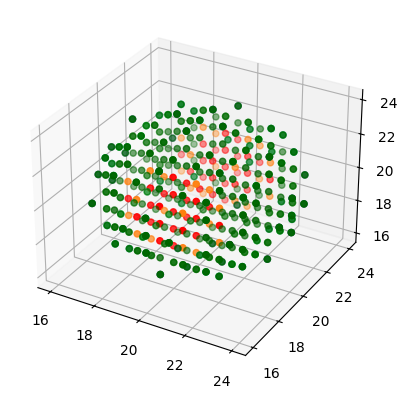

In [98]:
fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
ax.scatter(xs, ys, zs, c = "darkblue")
ax.scatter(xs1, ys1, zs1, c = "c")
ax.scatter(xs2, ys2, zs2, c = "springgreen")
ax.scatter(xs3, ys3, zs3, c = "g")
ax.scatter(xs4, ys4, zs4, c = "darkgreen")
ax.scatter(xs5, ys5, zs5, c = "tab:orange")
ax.scatter(xs6, ys6, zs6, c = "r")


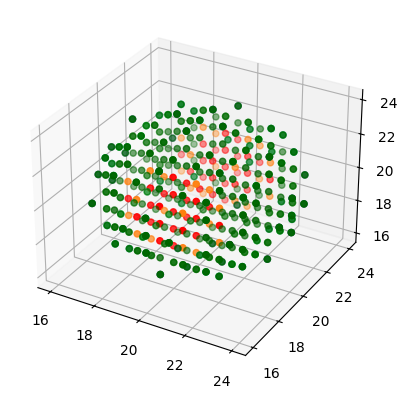

In [99]:
import math
import numpy as np
import matplotlib.pyplot as plt


def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r*2 if limit_r*2 < Offset_i else -Offset_i, limit_r*2 if limit_r*2 < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r*2 if limit_r*2 < Offset_j else -Offset_j, limit_r*2 if limit_r*2 < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r*2 if limit_r*2 < Offset_k else -Offset_k, limit_r*2 if limit_r*2 < limit-Offset_k else limit-Offset_k) 
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) <= limit_r
        if (sin_beta*(cos_alpha*i+sin_alpha*k)+cos_beta*j)**2 + (cos_alpha*k-sin_alpha*i)**2 <= (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j)**2
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) >= 0
        ] 
    
    return _Index_lst_im_Kegel


def has_duplicates(seq):
    duplicates = [i for i in seq if seq.count(i) > 1]
    #unique_lst = [i for i in seq if seq.count(i) == 1]
    #unique_lst, 
    return duplicates

indizes_des_Kegels_lst = []
lst_winkel_a = [i*math.pi/180 for i in range(0, 360, 2)]
lst_winkel_b = [i*math.pi/180 for i in range(-90, 90, 1)]

for i in range(0, 180):
    for j in range(0, 180):
        indizes_des_Kegels_lst += (indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=3, alpha=lst_winkel_a[j], beta=lst_winkel_b[i]))
    


rounded_lst_Kegel = [[round(i[0],5),round(i[1],5),round(i[2],5)] for i in indizes_des_Kegels_lst]

dict_duplicates = {}
for lst_for in rounded_lst_Kegel:
    if dict_duplicates.get(str(lst_for)) == None:
        dict_duplicates.update({str(lst_for):1})
    else:
        dict_duplicates[str(lst_for)] += 1
    
sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])


xs, ys, zs = [], [], []
xs1, ys1, zs1 = [], [], []
xs2, ys2, zs2 = [], [], []
xs3, ys3, zs3 = [], [], []
xs4, ys4, zs4 = [], [], []
xs5, ys5, zs5 = [], [], []
xs6, ys6, zs6 = [], [], []
xs7, ys7, zs7 = [], [], []
for i in [*dict_duplicates.keys()]:
    x_str, y_str, z_str_ = list(i.split("["))[1].split(",")
    x, y, z = int(x_str), int(y_str), int(z_str_.split("]")[0])
    if dict_duplicates[i] <= 300:
        xs.append(x)
        ys.append(y)
        zs.append(z)
    elif dict_duplicates[i] <= 1000:
        xs1.append(x)
        ys1.append(y)
        zs1.append(z)
    elif dict_duplicates[i] <= 1400:
        xs2.append(x)
        ys2.append(y)
        zs2.append(z)
    if dict_duplicates[i] <= 2500:
        xs3.append(x)
        ys3.append(y)
        zs3.append(z)
    if dict_duplicates[i] <= 4000:
        xs4.append(x)
        ys4.append(y)
        zs4.append(z)
    elif dict_duplicates[i] <= 5000:
        xs5.append(x)
        ys5.append(y)
        zs5.append(z)
    else:
        xs6.append(x)
        ys6.append(y)
        zs6.append(z)
        
fig = plt.figure()
ax = fig.add_subplot(projection = "3d")
ax.scatter(xs, ys, zs, c = "darkblue")
ax.scatter(xs1, ys1, zs1, c = "c")
ax.scatter(xs2, ys2, zs2, c = "springgreen")
ax.scatter(xs3, ys3, zs3, c = "g")
ax.scatter(xs4, ys4, zs4, c = "darkgreen")
ax.scatter(xs5, ys5, zs5, c = "tab:orange")
ax.scatter(xs6, ys6, zs6, c = "r")


plt.show()

In [105]:
from colour import Color
red = Color("red")
colors = list(red.range_to(Color("green"),8000))

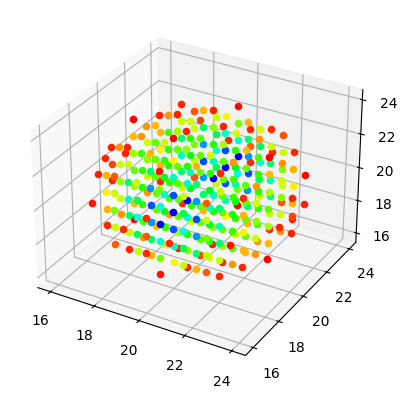

In [140]:
import math
import numpy as np
import matplotlib.pyplot as plt
from colour import Color
import random



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r*2 if limit_r*2 < Offset_i else -Offset_i, limit_r*2 if limit_r*2 < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r*2 if limit_r*2 < Offset_j else -Offset_j, limit_r*2 if limit_r*2 < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r*2 if limit_r*2 < Offset_k else -Offset_k, limit_r*2 if limit_r*2 < limit-Offset_k else limit-Offset_k) 
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) <= limit_r
        if (sin_beta*(cos_alpha*i+sin_alpha*k)+cos_beta*j)**2 + (cos_alpha*k-sin_alpha*i)**2 <= (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j)**2
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) > 0
        ] 
    
    return _Index_lst_im_Kegel


def has_duplicates(seq):
    duplicates = [i for i in seq if seq.count(i) > 1]
    #unique_lst = [i for i in seq if seq.count(i) == 1]
    #unique_lst, 
    return duplicates

indizes_des_Kegels_lst = []
lst_winkel_a = [i*math.pi/180 for i in range(0, 360, 2)]
lst_winkel_b = [i*math.pi/180 for i in range(0, 360, 2)]

for i in range(0, 180):
    for j in range(0, 180):
        indizes_des_Kegels_lst += (indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=3, alpha=lst_winkel_a[j], beta=lst_winkel_b[i]))
    


rounded_lst_Kegel = [[round(i[0],5),round(i[1],5),round(i[2],5)] for i in indizes_des_Kegels_lst]

dict_duplicates = {}
for lst_for in rounded_lst_Kegel:
    if dict_duplicates.get(str(lst_for)) == None:
        dict_duplicates.update({str(lst_for):1})
    else:
        dict_duplicates[str(lst_for)] += 1
    
sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])


fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

red = Color("red")
colors = list(red.range_to(Color("blue"), int(list(sorted_dict_duplicates[-1])[-1])+1))

for count, i in enumerate([*dict_duplicates.keys()]):
    x_str, y_str, z_str_ = list(i.split("["))[1].split(",")
    x, y, z = int(x_str), int(y_str), int(z_str_.split("]")[0])
    ax.scatter(x,y,z, c = str(colors[[*dict_duplicates.values()][count]]))
    
plt.show()

In [127]:
# intervall 0,360:0,360
sorted_dict_duplicates

[('[23, 20, 17]', 2),
 ('[23, 20, 23]', 2),
 ('[17, 20, 23]', 2),
 ('[17, 20, 17]', 2),
 ('[17, 23, 20]', 35),
 ('[23, 23, 20]', 36),
 ('[20, 23, 23]', 39),
 ('[20, 23, 17]', 39),
 ('[20, 17, 17]', 145),
 ('[17, 17, 20]', 146),
 ('[23, 17, 20]', 147),
 ('[20, 17, 23]', 148),
 ('[24, 20, 19]', 260),
 ('[21, 20, 24]', 260),
 ('[24, 20, 21]', 260),
 ('[19, 20, 24]', 260),
 ('[16, 20, 21]', 260),
 ('[16, 20, 19]', 260),
 ('[19, 20, 16]', 260),
 ('[21, 20, 16]', 260),
 ('[24, 19, 20]', 264),
 ('[24, 21, 20]', 264),
 ('[20, 19, 24]', 264),
 ('[20, 21, 24]', 264),
 ('[16, 19, 20]', 264),
 ('[16, 21, 20]', 264),
 ('[20, 19, 16]', 264),
 ('[20, 21, 16]', 264),
 ('[17, 18, 22]', 294),
 ('[18, 18, 17]', 294),
 ('[23, 18, 18]', 295),
 ('[22, 18, 23]', 295),
 ('[17, 22, 22]', 295),
 ('[17, 18, 18]', 295),
 ('[18, 22, 17]', 295),
 ('[22, 18, 17]', 295),
 ('[23, 18, 22]', 296),
 ('[23, 22, 18]', 296),
 ('[23, 22, 22]', 296),
 ('[22, 22, 23]', 296),
 ('[18, 18, 23]', 296),
 ('[18, 22, 23]', 296),
 ('[

In [125]:
# intervall -180,180:-90,90
sorted_dict_duplicates

[('[17, 17, 20]', 1),
 ('[17, 20, 17]', 1),
 ('[20, 17, 17]', 1),
 ('[23, 17, 20]', 1),
 ('[17, 20, 23]', 1),
 ('[20, 17, 23]', 1),
 ('[23, 20, 17]', 2),
 ('[23, 20, 23]', 2),
 ('[20, 23, 17]', 137),
 ('[20, 23, 23]', 137),
 ('[17, 23, 20]', 139),
 ('[23, 23, 20]', 141),
 ('[16, 20, 19]', 258),
 ('[19, 20, 16]', 258),
 ('[21, 20, 16]', 258),
 ('[24, 20, 19]', 258),
 ('[24, 20, 21]', 258),
 ('[21, 20, 24]', 258),
 ('[19, 20, 24]', 258),
 ('[16, 20, 21]', 258),
 ('[16, 21, 20]', 259),
 ('[20, 21, 16]', 259),
 ('[24, 21, 20]', 259),
 ('[20, 21, 24]', 259),
 ('[16, 19, 20]', 259),
 ('[20, 19, 16]', 259),
 ('[24, 19, 20]', 259),
 ('[20, 19, 24]', 259),
 ('[17, 22, 18]', 303),
 ('[17, 18, 18]', 303),
 ('[18, 22, 17]', 304),
 ('[22, 22, 17]', 304),
 ('[23, 22, 18]', 304),
 ('[23, 22, 22]', 304),
 ('[22, 22, 23]', 304),
 ('[18, 22, 23]', 304),
 ('[17, 22, 22]', 304),
 ('[18, 18, 17]', 304),
 ('[22, 18, 17]', 304),
 ('[23, 18, 18]', 304),
 ('[23, 18, 22]', 304),
 ('[22, 18, 23]', 304),
 ('[18, 

In [ ]:
# Random winkel:

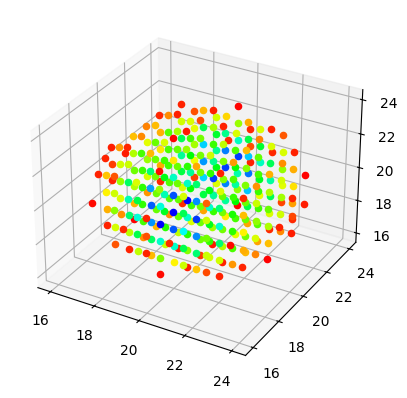

In [147]:
import math
import numpy as np
import matplotlib.pyplot as plt
from colour import Color
import random



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r*2 if limit_r*2 < Offset_i else -Offset_i, limit_r*2 if limit_r*2 < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r*2 if limit_r*2 < Offset_j else -Offset_j, limit_r*2 if limit_r*2 < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r*2 if limit_r*2 < Offset_k else -Offset_k, limit_r*2 if limit_r*2 < limit-Offset_k else limit-Offset_k) 
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) <= limit_r
        if (sin_beta*(cos_alpha*i+sin_alpha*k)+cos_beta*j)**2 + (cos_alpha*k-sin_alpha*i)**2 <= (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j)**2
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) > 0
        ] 
    
    return _Index_lst_im_Kegel


def has_duplicates(seq):
    duplicates = [i for i in seq if seq.count(i) > 1]
    #unique_lst = [i for i in seq if seq.count(i) == 1]
    #unique_lst, 
    return duplicates




# lst_winkel_a = np.array(random.sample(range(-180,180),number_of_winkel))*math.pi/180
# lst_winkel_b = np.array(random.sample(range(-90,90),number_of_winkel))*math.pi/180

number_of_winkel = 10000
lst_winkel_a, lst_winkel_b = [], []
for i in range(0,number_of_winkel):
    lst_winkel_a.append(random.randint(0, 360))
    lst_winkel_b.append(random.randint(0, 360))

lst_winkel_a, lst_winkel_b = np.array(lst_winkel_a)*math.pi/180, np.array(lst_winkel_b)*math.pi/180

indizes_des_Kegels_lst = []
for alpha_w, beta_w in zip(lst_winkel_a,lst_winkel_b):
    indizes_des_Kegels_lst += (indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=3, alpha=alpha_w, beta=beta_w))
    


rounded_lst_Kegel = [[round(i[0],5),round(i[1],5),round(i[2],5)] for i in indizes_des_Kegels_lst]

dict_duplicates = {}
for lst_for in rounded_lst_Kegel:
    if dict_duplicates.get(str(lst_for)) == None:
        dict_duplicates.update({str(lst_for):1})
    else:
        dict_duplicates[str(lst_for)] += 1
    
sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])


fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

red = Color("red")
colors = list(red.range_to(Color("blue"), int(list(sorted_dict_duplicates[-1])[-1])+1))

for count, i in enumerate([*dict_duplicates.keys()]):
    x_str, y_str, z_str_ = list(i.split("["))[1].split(",")
    x, y, z = int(x_str), int(y_str), int(z_str_.split("]")[0])
    ax.scatter(x,y,z, c = str(colors[[*dict_duplicates.values()][count]]))
    
plt.show()

In [132]:
# intervall 0,360:0,360
sorted_dict_duplicates

[('[24, 21, 20]', 54),
 ('[19, 24, 20]', 57),
 ('[21, 24, 20]', 58),
 ('[20, 21, 16]', 59),
 ('[20, 24, 21]', 61),
 ('[20, 24, 19]', 62),
 ('[16, 21, 20]', 68),
 ('[16, 20, 19]', 70),
 ('[20, 21, 24]', 71),
 ('[16, 19, 20]', 71),
 ('[23, 18, 22]', 73),
 ('[21, 20, 24]', 77),
 ('[20, 19, 24]', 77),
 ('[24, 20, 21]', 79),
 ('[20, 17, 23]', 79),
 ('[23, 17, 20]', 79),
 ('[23, 18, 18]', 81),
 ('[17, 17, 20]', 81),
 ('[19, 20, 16]', 82),
 ('[21, 20, 16]', 82),
 ('[17, 18, 22]', 82),
 ('[20, 17, 17]', 82),
 ('[24, 19, 20]', 84),
 ('[20, 19, 16]', 84),
 ('[17, 18, 18]', 89),
 ('[19, 20, 24]', 90),
 ('[23, 22, 22]', 90),
 ('[18, 18, 17]', 93),
 ('[18, 18, 23]', 94),
 ('[20, 16, 21]', 97),
 ('[22, 18, 23]', 98),
 ('[19, 16, 20]', 98),
 ('[16, 20, 21]', 99),
 ('[20, 16, 19]', 100),
 ('[17, 22, 18]', 102),
 ('[23, 22, 18]', 102),
 ('[22, 18, 17]', 104),
 ('[24, 20, 19]', 105),
 ('[21, 16, 20]', 105),
 ('[18, 22, 23]', 110),
 ('[22, 22, 17]', 115),
 ('[22, 22, 23]', 115),
 ('[17, 22, 22]', 119),
 

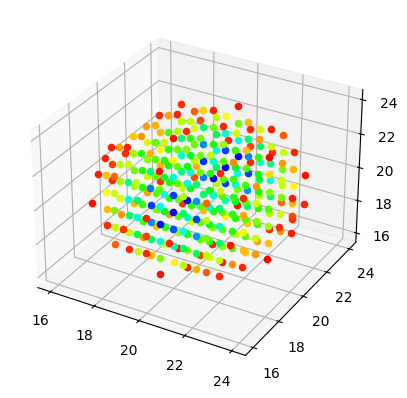

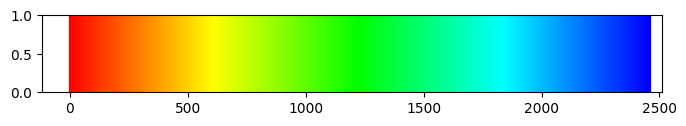

In [203]:
import math
import numpy as np
import matplotlib.pyplot as plt
from colour import Color
import random



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r*2 if limit_r*2 < Offset_i else -Offset_i, limit_r*2 if limit_r*2 < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r*2 if limit_r*2 < Offset_j else -Offset_j, limit_r*2 if limit_r*2 < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r*2 if limit_r*2 < Offset_k else -Offset_k, limit_r*2 if limit_r*2 < limit-Offset_k else limit-Offset_k) 
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) <= limit_r
        if (sin_beta*(cos_alpha*i+sin_alpha*k)+cos_beta*j)**2 + (cos_alpha*k-sin_alpha*i)**2 <= (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j)**2
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) > 0
        ] 
    
    return _Index_lst_im_Kegel



# lst_winkel_a = np.array(random.sample(range(-180,180),number_of_winkel))*math.pi/180
# lst_winkel_b = np.array(random.sample(range(-90,90),number_of_winkel))*math.pi/180

number_of_winkel = 10000
lst_winkel_a, lst_winkel_b = [], []
for i in range(0,number_of_winkel):
    lst_winkel_a.append(random.randint(-180, 180))
    lst_winkel_b.append(random.randint(-90, 90))

lst_winkel_a, lst_winkel_b = np.array(lst_winkel_a)*math.pi/180, np.array(lst_winkel_b)*math.pi/180

indizes_des_Kegels_lst = []
for alpha_w, beta_w in zip(lst_winkel_a,lst_winkel_b):
    indizes_des_Kegels_lst += (indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=3, alpha=alpha_w, beta=beta_w))
    


rounded_lst_Kegel = [[round(i[0],5),round(i[1],5),round(i[2],5)] for i in indizes_des_Kegels_lst]

dict_duplicates = {}
for lst_for in rounded_lst_Kegel:
    if dict_duplicates.get(str(lst_for)) == None:
        dict_duplicates.update({str(lst_for):1})
    else:
        dict_duplicates[str(lst_for)] += 1
    
sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])


fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

red = Color("red")
colors = list(red.range_to(Color("blue"), int(list(sorted_dict_duplicates[-1])[-1])+1))

for count, i in enumerate([*dict_duplicates.keys()]):
    x_str, y_str, z_str_ = list(i.split("["))[1].split(",")
    x, y, z = int(x_str), int(y_str), int(z_str_.split("]")[0])
    ax.scatter(x,y,z, c = str(colors[[*dict_duplicates.values()][count]]))
    
    
#Plot Colormap
x_color = range(int(list(sorted_dict_duplicates[-1])[-1])+1)
dict_colors = dict(zip(x_color,colors))
color_f = lambda n : dict_colors.get(n)

fig1, ax1 = plt.subplots(figsize=(8, 1))

for x_arg in x_color:
    ax1.axvline(x_arg, color=str(color_f(x_arg)))
    
plt.tight_layout()    
plt.show()

In [134]:
# intervall -180,180:-90,90
sorted_dict_duplicates

[('[20, 21, 16]', 48),
 ('[16, 19, 20]', 52),
 ('[16, 21, 20]', 52),
 ('[21, 20, 16]', 56),
 ('[20, 19, 16]', 61),
 ('[24, 20, 19]', 61),
 ('[19, 20, 16]', 66),
 ('[16, 20, 19]', 68),
 ('[16, 20, 21]', 68),
 ('[24, 19, 20]', 69),
 ('[19, 20, 24]', 71),
 ('[22, 18, 17]', 72),
 ('[18, 18, 17]', 74),
 ('[21, 20, 24]', 75),
 ('[24, 21, 20]', 79),
 ('[23, 18, 18]', 82),
 ('[22, 22, 17]', 83),
 ('[24, 20, 21]', 83),
 ('[20, 16, 21]', 85),
 ('[21, 16, 20]', 86),
 ('[23, 22, 18]', 91),
 ('[20, 16, 19]', 92),
 ('[18, 22, 17]', 93),
 ('[17, 18, 22]', 93),
 ('[18, 18, 23]', 94),
 ('[20, 19, 24]', 103),
 ('[17, 18, 18]', 104),
 ('[20, 24, 19]', 105),
 ('[22, 18, 23]', 108),
 ('[20, 24, 21]', 108),
 ('[19, 16, 20]', 111),
 ('[20, 21, 24]', 112),
 ('[23, 18, 22]', 113),
 ('[18, 22, 23]', 115),
 ('[19, 24, 20]', 115),
 ('[17, 22, 22]', 116),
 ('[16, 20, 20]', 116),
 ('[21, 24, 20]', 119),
 ('[23, 22, 22]', 124),
 ('[17, 22, 18]', 126),
 ('[22, 22, 23]', 134),
 ('[24, 20, 20]', 139),
 ('[20, 20, 16]',

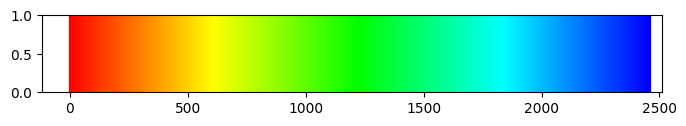

In [204]:
#Plot Colormap
x_color = range(int(list(sorted_dict_duplicates[-1])[-1])+1)
dict_colors = dict(zip(x_color,colors))
color_f = lambda n : dict_colors.get(n)

fig, ax = plt.subplots(figsize=(8, 1))

for x_arg in x_color:
    ax.axvline(x_arg, color=str(color_f(x_arg)))
plt.show()


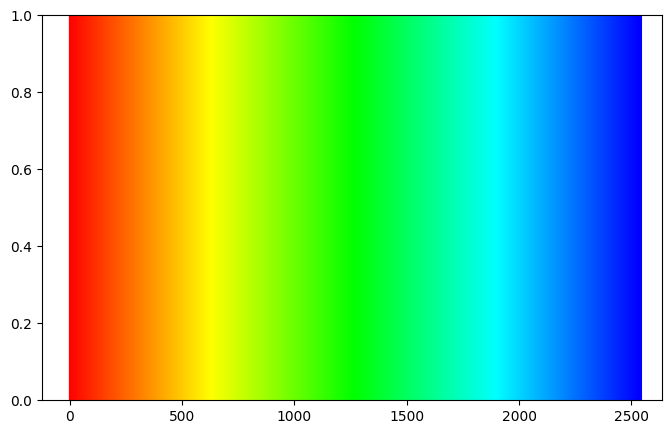

In [ ]:
# Der plot zeigt, das Kegel entlang der y achse ca doppelt so wahrscheinlich sind wie in andere richtungen

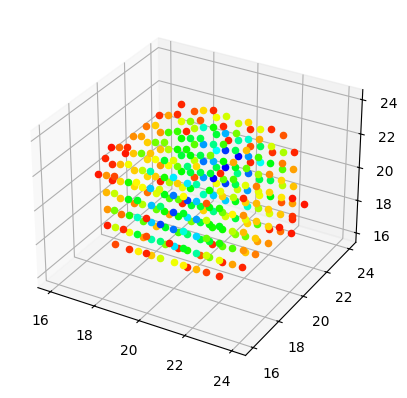

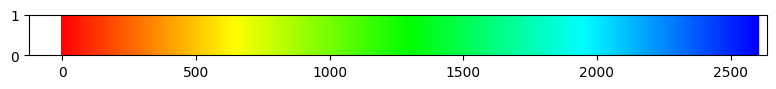

In [215]:
import math
import numpy as np
import matplotlib.pyplot as plt
from colour import Color
import random



def indizes_des_Kegels(limit=25, Offset_i=12, Offset_j=12, Offset_k=12, limit_r=7, alpha=0, beta=0):
    # Länge des Kegels
    # limit_r = 10
    # Offset des Kegels in x-Richtung
    # Offset_i, Offset_j, Offset_k = 12,12,12
    # alpha: drehwinkel um die j/x-Achse, beta: drehwinkel um die k/z-Achse
    # Größe der N**3 Matrix
    # limit = 25
    # gedrehtes i, i k:
    # i = (np.cos(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)-np.sin(beta)*j)
    # j = (np.sin(beta)*(np.cos(alpha)*i+np.sin(alpha)*k)+np.cos(beta)*j)
    # k = (np.cos(alpha)*k-np.sin(alpha)*i)
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    
    _Index_lst_im_Kegel =[[i+Offset_i,j+Offset_j,k+Offset_k] 
        for i in range(-limit_r*2 if limit_r*2 < Offset_i else -Offset_i, limit_r*2 if limit_r*2 < limit-Offset_i else limit-Offset_i) 
        for j in range(-limit_r*2 if limit_r*2 < Offset_j else -Offset_j, limit_r*2 if limit_r*2 < limit-Offset_j else limit-Offset_j) 
        for k in range(-limit_r*2 if limit_r*2 < Offset_k else -Offset_k, limit_r*2 if limit_r*2 < limit-Offset_k else limit-Offset_k) 
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) <= limit_r
        if (sin_beta*(cos_alpha*i+sin_alpha*k)+cos_beta*j)**2 + (cos_alpha*k-sin_alpha*i)**2 <= (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j)**2
        if (cos_beta*(cos_alpha*i+sin_alpha*k)-sin_beta*j) > 0
        ]  
    
    return _Index_lst_im_Kegel



# lst_winkel_a = np.array(random.sample(range(-180,180),number_of_winkel))*math.pi/180
# lst_winkel_b = np.array(random.sample(range(-90,90),number_of_winkel))*math.pi/180

# number_of_winkel = 10000
# lst_winkel_a, lst_winkel_b = [], []
# for i in range(0,number_of_winkel):
#     lst_winkel_a.append(np.arccos(1-2*random.uniform(0,1)))
#     lst_winkel_b.append(random.uniform(0, 1)*math.pi*2)
    

number_of_winkel = 10000
lst_winkel_a = np.arccos(1-2*(np.random.rand(1,number_of_winkel)))
lst_winkel_b = np.random.rand(1,number_of_winkel)*math.pi*2


indizes_des_Kegels_lst = []
for alpha_w, beta_w in zip(lst_winkel_a[0],lst_winkel_b[0]):
    indizes_des_Kegels_lst += (indizes_des_Kegels(limit=40, Offset_i=20, Offset_j=20, Offset_k=20, limit_r=3, alpha=alpha_w, beta=beta_w))
    


rounded_lst_Kegel = [[round(i[0],5),round(i[1],5),round(i[2],5)] for i in indizes_des_Kegels_lst]

dict_duplicates = {}
for lst_for in rounded_lst_Kegel:
    if dict_duplicates.get(str(lst_for)) == None:
        dict_duplicates.update({str(lst_for):1})
    else:
        dict_duplicates[str(lst_for)] += 1
    
sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])


fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

red = Color("red")
colors = list(red.range_to(Color("blue"), int(list(sorted_dict_duplicates[-1])[-1])+1))

for count, i in enumerate([*dict_duplicates.keys()]):
    x_str, y_str, z_str_ = list(i.split("["))[1].split(",")
    x, y, z = int(x_str), int(y_str), int(z_str_.split("]")[0])
    ax.scatter(x,y,z, c = str(colors[[*dict_duplicates.values()][count]]))
    
    
#Plot Colormap
x_color = range(int(list(sorted_dict_duplicates[-1])[-1])+1)
dict_colors = dict(zip(x_color,colors))
color_f = lambda n : dict_colors.get(n)

fig1, ax1 = plt.subplots(figsize=(8, 1))

for x_arg in x_color:
    ax1.axvline(x_arg, color=str(color_f(x_arg)))
    
plt.tight_layout()    
plt.show()

In [213]:
np.arccos(1-2*(np.random.rand(1,number_of_winkel)))[0]

array([0.55904128, 0.84341882, 1.45473095, ..., 1.45780436, 1.59356911,
       0.95471419])

# np.meshgrid, Ansatz

In [251]:
range_r = 7
# x = np.arange(range_r-1,range_r+1,1)
# y = np.arange(range_r-1,range_r+1,1)

x=np.linspace(0,5,6)
y=np.linspace(-5,5,11)
print(x)
print(y)

[0. 1. 2. 3. 4. 5.]
[-5. -4. -3. -2. -1.  0.  1.  2.  3.  4.  5.]


In [252]:
X_mesh,Y_mesh = np.meshgrid(x,y)
Z_mesh = np.sqrt(X_mesh**2 - Y_mesh**2)

/tmp/ipykernel_3788/1976354070.py:2: RuntimeWarning: invalid value encountered in sqrt
  Z_mesh = np.sqrt(X_mesh**2 - Y_mesh**2)


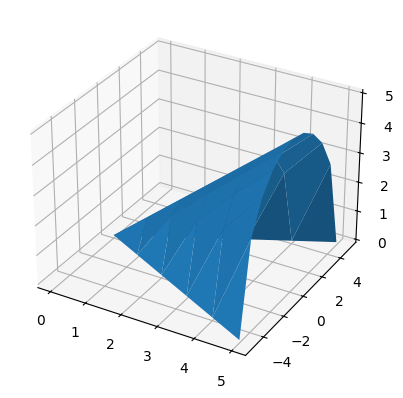

In [253]:
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.plot_surface(X_mesh,Y_mesh,Z_mesh)

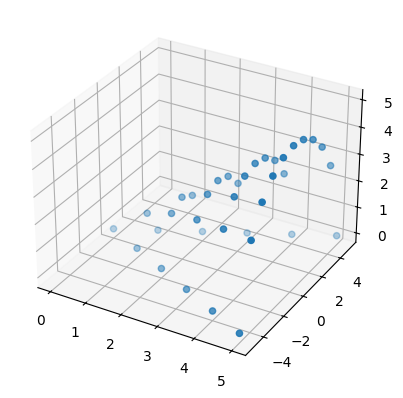

In [254]:
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(X_mesh,Y_mesh,Z_mesh)

[0. 1. 2. 3. 4. 5.]
[-5. -4. -3. -2. -1.  0.  1.  2.  3.  4.  5.]


/tmp/ipykernel_3788/4123047937.py:11: RuntimeWarning: invalid value encountered in sqrt
  Z_mesh = np.sqrt(X_mesh**2 - Y_mesh**2)


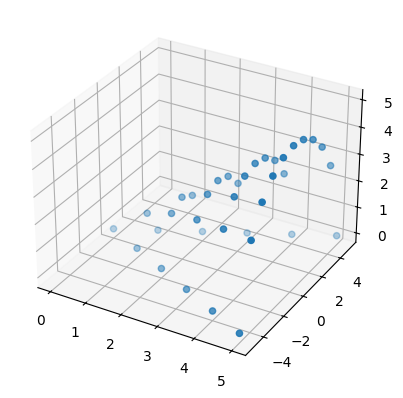

In [255]:
import numpy as np
import matplotlib.pyplot as plt

range_r = 7
# x = np.arange(range_r-1,range_r+1,1)
# y = np.arange(range_r-1,range_r+1,1)

x=np.linspace(0,5,6)
y=np.linspace(-5,5,11)
print(x)
print(y)

X_mesh,Y_mesh = np.meshgrid(x,y)
Z_mesh = np.sqrt(X_mesh**2 - Y_mesh**2)

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(X_mesh,Y_mesh,Z_mesh)

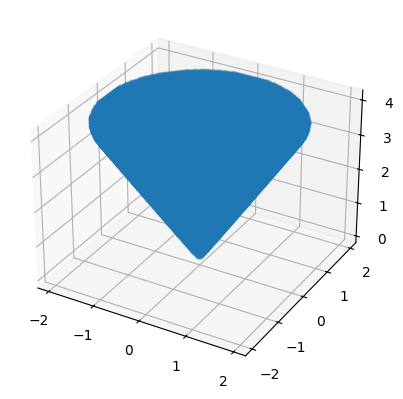

In [256]:
import numpy as np

def generate_cone_points(radius, height, length):
    # Erstelle ein Gitter entlang der x-, y- und z-Achsen
    x = np.linspace(-radius, radius, length)
    y = np.linspace(-radius, radius, length)
    z = np.linspace(-radius, height, length)

    # Erstelle das Gitter für x, y und z
    x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

    # Wende die Kegelgleichung an, um Punkte innerhalb des Kegels zu filtern
    mask = (x_grid**2 + y_grid**2) <= ((z_grid/height)*radius)**2 and x_grid > 0

    # Filtere Punkte innerhalb des Kegels
    x_points = x_grid[mask]
    y_points = y_grid[mask]
    z_points = z_grid[mask]

    return x_points, y_points, z_points

# Definiere die Parameter des Kegels
radius = 2
height = 4
length = 5

# Generiere die Punkte innerhalb des Kegels
x_points, y_points, z_points = generate_cone_points(radius, height, length)

# Gib die generierten Punkte aus

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_points, y_points, z_points)

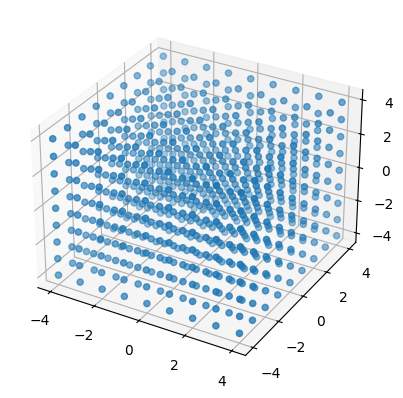

In [260]:
range_r = 4

x = np.linspace(-range_r, range_r, range_r*2+1)
y = np.linspace(-range_r, range_r, range_r*2+1)
z = np.linspace(-range_r, range_r, range_r*2+1)

# Erstelle das Gitter für x, y und z
x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_grid, y_grid, z_grid)

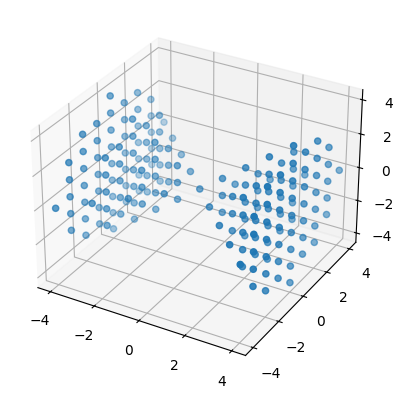

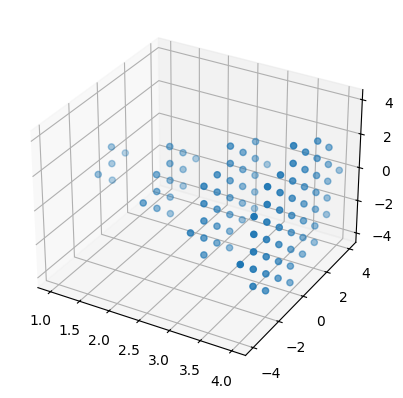

In [269]:
mask_1 = ((z_grid**2 + y_grid**2) <= x_grid**2)

# Filtere Punkte innerhalb des Kegels
x_mask1 = x_grid[mask_1]
y_mask1 = y_grid[mask_1]
z_mask1 = z_grid[mask_1]

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_mask1, y_mask1, z_mask1)
plt.show()

mask_2 = x_mask1 > 0
x_mask2 = x_mask1[mask_2]
y_mask2 = y_mask1[mask_2]
z_mask2 = z_mask1[mask_2]

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_mask2, y_mask2, z_mask2)
plt.show()

In [ ]:
# Rotationsmatrix um die z-Achse
cos_alpha = np.cos(alpha)
sin_alpha = np.sin(alpha)
rotation_matrix_alpha = np.array([[cos_alpha, -sin_alpha, 0],
                            [sin_alpha, cos_alpha, 0],
                            [0, 0, 1]])


# Rotationsmatrix um die y-Achse
cos_beta = np.cos(beta)
sin_beta = np.sin(beta)
rotation_matrix_beta = np.array([[cos_beta, 0, sin_beta],
                            [0, 1, 0],
                            [-sin_beta, 0, cos_beta]])


rotation_matrix = np.matmul(rotation_matrix_beta,rotation_matrix_alpha)

# Wende die Rotationsmatrix auf die x- und y-Koordinaten an
x_rotated, y_rotated, z_rotated = np.dot(rotation_matrix, np.vstack([x_grid.flatten(), y_grid.flatten(), z_grid.flatten()]))

# Setze die neuen x- und y-Koordinaten in das Gitter
x_grid = x_rotated.reshape(x_grid.shape)
y_grid = y_rotated.reshape(y_grid.shape)
z_grid = z_rotated.reshape(z_grid.shape)

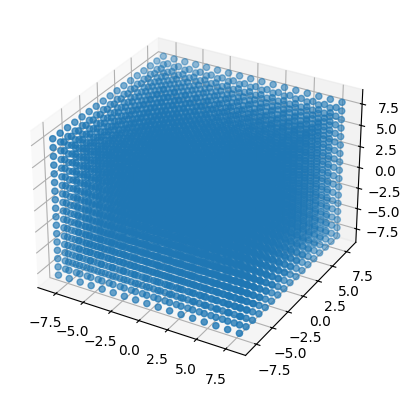

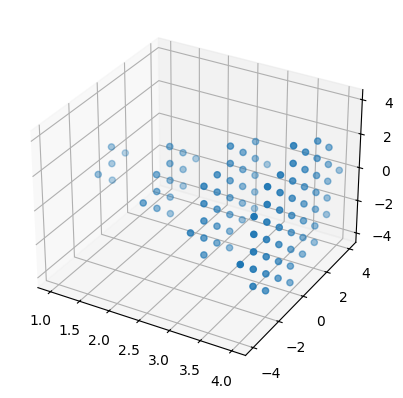

In [303]:
range_r = 4
alpha = math.pi/180*90
beta = math.pi/180*0
x_koord, y_koord, z_koord = 2,2,2

x = np.linspace(-range_r*2, range_r*2, range_r*4+1)
y = np.linspace(-range_r*2, range_r*2, range_r*4+1)
z = np.linspace(-range_r*2, range_r*2, range_r*4+1)

# Erstelle das Gitter für x, y und z
x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

############ Scatter Plot
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_grid, y_grid, z_grid)
plt.show()
############

# Mask für innerhalb des Zylinders
mask = ((z_grid**2 + y_grid**2) <= x_grid**2) & (0 < x_grid) & (range_r >= x_grid)
# Filtere Punkte innerhalb des Kegels
x_mask = x_grid[mask]
y_mask = y_grid[mask]
z_mask = z_grid[mask]

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_mask, y_mask, z_mask)
plt.show()

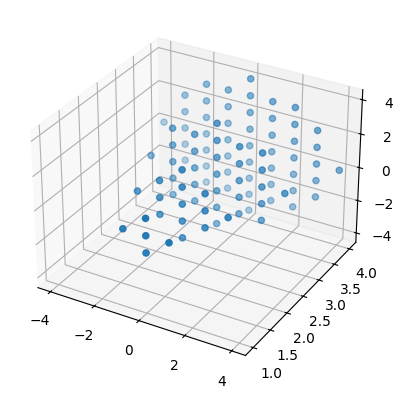

In [304]:
# Rotationsmatrix um die z-Achse
cos_alpha = np.cos(alpha)
sin_alpha = np.sin(alpha)
rotation_matrix_alpha = np.array([[cos_alpha, -sin_alpha, 0],
                            [sin_alpha, cos_alpha, 0],
                            [0, 0, 1]])


# Rotationsmatrix um die y-Achse
cos_beta = np.cos(beta)
sin_beta = np.sin(beta)
rotation_matrix_beta = np.array([[cos_beta, 0, sin_beta],
                            [0, 1, 0],
                            [-sin_beta, 0, cos_beta]])


rotation_matrix = np.matmul(rotation_matrix_beta,rotation_matrix_alpha)

# Wende die Rotationsmatrix auf die x- und y-Koordinaten an
x_rotated, y_rotated, z_rotated = np.dot(rotation_matrix, np.vstack([x_mask.flatten(), y_mask.flatten(), z_mask.flatten()]))

# Setze die neuen x- und y-Koordinaten in das Gitter
x_mask = x_rotated.reshape(x_mask.shape)
y_mask = y_rotated.reshape(y_mask.shape)
z_mask = z_rotated.reshape(z_mask.shape)


############ Scatter Plot
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_mask, y_mask, z_mask)
plt.show()
############

In [ ]:
####################### Falsch

import numpy as np
import matplotlib.pyplot as plt
import math

range_r = 4
alpha = math.pi/180*30
beta = math.pi/180*0
x_koord, y_koord, z_koord = 2,2,2

x = np.linspace(-range_r*2 + x_koord, range_r*2 + x_koord, range_r*4 + 1)
y = np.linspace(-range_r*2 + y_koord, range_r*2 + y_koord, range_r*4 + 1)
z = np.linspace(-range_r*2 + z_koord, range_r*2 + z_koord, range_r*4 + 1)

# Erstelle das Gitter für x, y und z
x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

############ Scatter Plot
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_grid, y_grid, z_grid)
plt.show()
############

# Mask für innerhalb des Zylinders
mask = (((z_grid + z_koord)**2 + (y_grid + y_koord)**2) <= (x_grid + x_koord)**2) & (0 <= x_grid + x_koord) & (range_r >= x_grid + x_koord)
# Filtere Punkte innerhalb des Kegels
x_mask = x_grid[mask]
y_mask = y_grid[mask]
z_mask = z_grid[mask]

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_mask, y_mask, z_mask)
plt.show()

# Rotationsmatrix um die z-Achse
cos_alpha = np.cos(alpha)
sin_alpha = np.sin(alpha)
rotation_matrix_alpha = np.array([[cos_alpha, -sin_alpha, 0],
                            [sin_alpha, cos_alpha, 0],
                            [0, 0, 1]])


# Rotationsmatrix um die y-Achse
cos_beta = np.cos(beta)
sin_beta = np.sin(beta)
rotation_matrix_beta = np.array([[cos_beta, 0, sin_beta],
                            [0, 1, 0],
                            [-sin_beta, 0, cos_beta]])


rotation_matrix = np.matmul(rotation_matrix_beta,rotation_matrix_alpha)

# Wende die Rotationsmatrix auf die x- und y-Koordinaten an
x_rotated, y_rotated, z_rotated = np.dot(rotation_matrix, np.vstack([x_mask.flatten(), y_mask.flatten(), z_mask.flatten()]))

# Setze die neuen x- und y-Koordinaten in das Gitter
x_mask = x_rotated.reshape(x_mask.shape)
y_mask = y_rotated.reshape(y_mask.shape)
z_mask = z_rotated.reshape(z_mask.shape)


############ Scatter Plot
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_mask, y_mask, z_mask)
plt.show()
############ Falsch


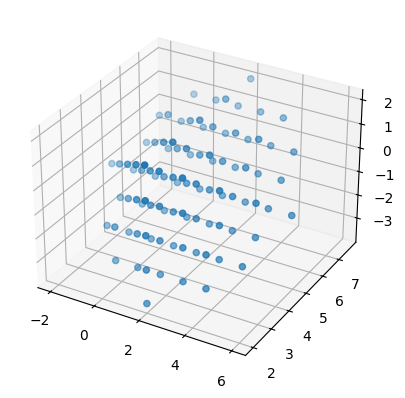

In [321]:
import numpy as np
import matplotlib.pyplot as plt
import math

range_r = 4
alpha = math.pi/180*90
beta = math.pi/180*45
x_koord, y_koord, z_koord = 2,2,2

x = np.linspace(-range_r*2, range_r*2, range_r*4+1)
y = np.copy(x)
z = np.copy(x)
# y = np.linspace(-range_r*2, range_r*2, range_r*4+1)
# z = np.linspace(-range_r*2, range_r*2, range_r*4+1)

# Erstelle das Gitter für x, y und z
x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

# ############ Scatter Plot
# fig = plt.figure()
# ax = plt.axes(projection='3d')
# ax.scatter(x_grid, y_grid, z_grid)
# plt.show()
# ############

# Mask für innerhalb des Zylinders
mask = ((z_grid**2 + y_grid**2) <= x_grid**2) & (0 <= x_grid) & (range_r >= x_grid)
# Filtere Punkte innerhalb des Kegels
x_mask = x_grid[mask]
y_mask = y_grid[mask]
z_mask = z_grid[mask]

# ############ Scatter Plot
# fig = plt.figure()
# ax = plt.axes(projection='3d')
# ax.scatter(x_mask, y_mask, z_mask)
# plt.show()
# ###########

# Rotationsmatrix um die z-Achse
cos_alpha = np.cos(alpha)
sin_alpha = np.sin(alpha)
rotation_matrix_alpha = np.array([[cos_alpha, -sin_alpha, 0],
                            [sin_alpha, cos_alpha, 0],
                            [0, 0, 1]])


# Rotationsmatrix um die y-Achse
cos_beta = np.cos(beta)
sin_beta = np.sin(beta)
rotation_matrix_beta = np.array([[cos_beta, 0, sin_beta],
                            [0, 1, 0],
                            [-sin_beta, 0, cos_beta]])


rotation_matrix = np.matmul(rotation_matrix_alpha, rotation_matrix_beta)

# Wende die Rotationsmatrix auf die x- und y-Koordinaten an
x_rotated, y_rotated, z_rotated = np.dot(rotation_matrix, np.vstack([x_mask.flatten(), y_mask.flatten(), z_mask.flatten()]))

# Setze die neuen x- und y-Koordinaten in das Gitter
x_mask = x_rotated.reshape(x_mask.shape) + x_koord
y_mask = y_rotated.reshape(y_mask.shape) + y_koord
z_mask = z_rotated.reshape(z_mask.shape) + z_koord


############ Scatter Plot
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_mask, y_mask, z_mask)
plt.show()
############

In [311]:
rotation_matrix
#90, 20

array([[ 5.75395780e-17, -9.39692621e-01,  3.42020143e-01],
       [ 1.00000000e+00,  6.12323400e-17,  0.00000000e+00],
       [-2.09426937e-17,  3.42020143e-01,  9.39692621e-01]])

In [313]:
rotation_matrix
#90, 40

array([[ 4.69066938e-17, -7.66044443e-01,  6.42787610e-01],
       [ 1.00000000e+00,  6.12323400e-17,  0.00000000e+00],
       [-3.93593894e-17,  6.42787610e-01,  7.66044443e-01]])

In [315]:
rotation_matrix
#90, 60

array([[ 3.06161700e-17, -5.00000000e-01,  8.66025404e-01],
       [ 1.00000000e+00,  6.12323400e-17,  0.00000000e+00],
       [-5.30287619e-17,  8.66025404e-01,  5.00000000e-01]])

In [ ]:
# Drehmatrixprodukt umgedreht.... mal gucken was nun anders läuft

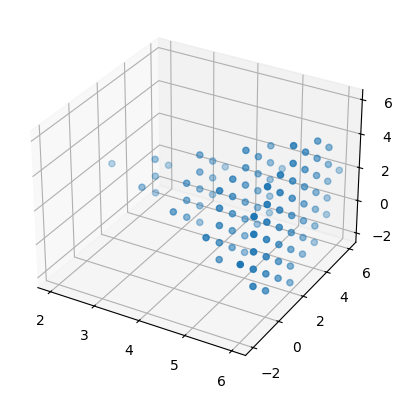

In [322]:
import numpy as np
import matplotlib.pyplot as plt
import math

def koords_in_kegel(x_koord = 0, y_koord = 0, z_koord = 0, alpha = 0, beta = 0 , range_r = 4):
    x = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    y = np.copy(x)
    z = np.copy(x)
    # y = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    # z = np.linspace(-range_r*2, range_r*2, range_r*4+1)

    # Erstelle das Gitter für x, y und z
    x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_grid, y_grid, z_grid)
    # plt.show()
    # ############

    # Mask für innerhalb des Zylinders
    mask = ((z_grid**2 + y_grid**2) <= x_grid**2) & (0 <= x_grid) & (range_r >= x_grid)
    # Filtere Punkte innerhalb des Kegels
    x_mask = x_grid[mask]
    y_mask = y_grid[mask]
    z_mask = z_grid[mask]

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_mask, y_mask, z_mask)
    # plt.show()
    # ###########

    # Rotationsmatrix um die z-Achse
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    rotation_matrix_alpha = np.array([[cos_alpha, -sin_alpha, 0],
                                [sin_alpha, cos_alpha, 0],
                                [0, 0, 1]])


    # Rotationsmatrix um die y-Achse
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    rotation_matrix_beta = np.array([[cos_beta, 0, sin_beta],
                                [0, 1, 0],
                                [-sin_beta, 0, cos_beta]])


    rotation_matrix = np.matmul(rotation_matrix_alpha, rotation_matrix_beta)

    # Wende die Rotationsmatrix auf die x- und y-Koordinaten an
    x_rotated, y_rotated, z_rotated = np.dot(rotation_matrix, np.vstack([x_mask.flatten(), y_mask.flatten(), z_mask.flatten()]))

    # Setze die neuen x- und y-Koordinaten in das Gitter
    x_mask = x_rotated.reshape(x_mask.shape) + x_koord
    y_mask = y_rotated.reshape(y_mask.shape) + y_koord
    z_mask = z_rotated.reshape(z_mask.shape) + z_koord
    return x_mask, y_mask, z_mask


x_mask, y_mask, z_mask = koords_in_kegel(2,2,2,0,0,4)
############ Scatter Plot
fig = plt.figure()
ax = plt.axes(projection='3d')
ax.scatter(x_mask, y_mask, z_mask)
plt.show()
############

In [354]:
a = np.array(koords_in_kegel(2,2,2,0,0,4))

b = np.array([[],[],[]])
b = np.hstack((b, a))
print(b)

[[ 6.  5.  6.  6.  6.  6.  6.  4.  5.  5.  5.  5.  5.  6.  6.  6.  6.  6.
   6.  6.  3.  4.  4.  4.  5.  5.  5.  5.  5.  6.  6.  6.  6.  6.  6.  6.
   2.  3.  3.  3.  4.  4.  4.  4.  4.  5.  5.  5.  5.  5.  5.  5.  6.  6.
   6.  6.  6.  6.  6.  6.  6.  3.  4.  4.  4.  5.  5.  5.  5.  5.  6.  6.
   6.  6.  6.  6.  6.  4.  5.  5.  5.  5.  5.  6.  6.  6.  6.  6.  6.  6.
   5.  6.  6.  6.  6.  6.  6.]
 [-2. -1. -1. -1. -1. -1. -1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
   2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.
   2.  2.  2.  2.  2.  2.  2.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.
   3.  3.  3.  3.  3.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.  4.
   5.  5.  5.  5.  5.  5.  6.]
 [ 2.  2.  0.  1.  2.  3.  4.  2.  0.  1.  2.  3.  4. -1.  0.  1.  2.  3.
   4.  5.  2.  1.  2.  3.  0.  1.  2.  3.  4. -1.  0.  1.  2.  3.  4.  5.
   2.  1.  2.  3.  0.  1.  2.  3.  4. -1.  0.  1. 

In [355]:
b = np.hstack((b, a))
print(b)

[[ 6.  5.  6.  6.  6.  6.  6.  4.  5.  5.  5.  5.  5.  6.  6.  6.  6.  6.
   6.  6.  3.  4.  4.  4.  5.  5.  5.  5.  5.  6.  6.  6.  6.  6.  6.  6.
   2.  3.  3.  3.  4.  4.  4.  4.  4.  5.  5.  5.  5.  5.  5.  5.  6.  6.
   6.  6.  6.  6.  6.  6.  6.  3.  4.  4.  4.  5.  5.  5.  5.  5.  6.  6.
   6.  6.  6.  6.  6.  4.  5.  5.  5.  5.  5.  6.  6.  6.  6.  6.  6.  6.
   5.  6.  6.  6.  6.  6.  6.  6.  5.  6.  6.  6.  6.  6.  4.  5.  5.  5.
   5.  5.  6.  6.  6.  6.  6.  6.  6.  3.  4.  4.  4.  5.  5.  5.  5.  5.
   6.  6.  6.  6.  6.  6.  6.  2.  3.  3.  3.  4.  4.  4.  4.  4.  5.  5.
   5.  5.  5.  5.  5.  6.  6.  6.  6.  6.  6.  6.  6.  6.  3.  4.  4.  4.
   5.  5.  5.  5.  5.  6.  6.  6.  6.  6.  6.  6.  4.  5.  5.  5.  5.  5.
   6.  6.  6.  6.  6.  6.  6.  5.  6.  6.  6.  6.  6.  6.]
 [-2. -1. -1. -1. -1. -1. -1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
   2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.  2.

In [387]:

import numpy as np
import matplotlib.pyplot as plt
import math

def koords_in_kegel(x_koord = 0, y_koord = 0, z_koord = 0, alpha = 0, beta = 0 , range_r = 4):
    x = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    y = np.copy(x)
    z = np.copy(x)
    # y = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    # z = np.linspace(-range_r*2, range_r*2, range_r*4+1)

    # Erstelle das Gitter für x, y und z
    x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_grid, y_grid, z_grid)
    # plt.show()
    # ############

    # Mask für innerhalb des Zylinders
    mask = ((z_grid**2 + y_grid**2) <= x_grid**2) & (0 <= x_grid) & (range_r >= x_grid)
    # Filtere Punkte innerhalb des Kegels
    x_mask = x_grid[mask]
    y_mask = y_grid[mask]
    z_mask = z_grid[mask]

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_mask, y_mask, z_mask)
    # plt.show()
    # ###########

    # Rotationsmatrix um die z-Achse
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    rotation_matrix_alpha = np.array([[cos_alpha, -sin_alpha, 0],
                                [sin_alpha, cos_alpha, 0],
                                [0, 0, 1]])


    # Rotationsmatrix um die y-Achse
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    rotation_matrix_beta = np.array([[cos_beta, 0, sin_beta],
                                [0, 1, 0],
                                [-sin_beta, 0, cos_beta]])


    rotation_matrix = np.matmul(rotation_matrix_alpha, rotation_matrix_beta)

    # Wende die Rotationsmatrix auf die x- und y-Koordinaten an
    x_rotated, y_rotated, z_rotated = np.dot(rotation_matrix, np.vstack([x_mask.flatten(), y_mask.flatten(), z_mask.flatten()]))

    # Setze die neuen x- und y-Koordinaten in das Gitter
    x_mask = x_rotated.reshape(x_mask.shape) + x_koord
    y_mask = y_rotated.reshape(y_mask.shape) + y_koord
    z_mask = z_rotated.reshape(z_mask.shape) + z_koord
    return x_mask, y_mask, z_mask



number_of_winkel = 10000
lst_winkel_a = np.arccos(1-2*(np.random.rand(1,number_of_winkel)))
lst_winkel_b = np.random.rand(1,number_of_winkel)*math.pi*2


indizes_des_Kegels_lst = np.array([[],[],[]])
for alpha_w, beta_w in zip(lst_winkel_a[0],lst_winkel_b[0]):
    indizes_des_Kegels_lst =  np.hstack((indizes_des_Kegels_lst, np.array(koords_in_kegel(20, 20, 20, range_r = 3, alpha = alpha_w, beta = beta_w))))
    

rounded_lst_Kegel = np.rint(indizes_des_Kegels_lst)




In [415]:
test = list(np.transpose(rounded_lst_Kegel))
dict_duplicates = {}
for lst_for in test:
    if dict_duplicates.get(str(lst_for)) == None:
        dict_duplicates.update({str(lst_for):1})
    else:
        dict_duplicates[str(lst_for)] += 1

In [416]:
dict_duplicates = {}
for lst_for in np.transpose(rounded_lst_Kegel):
    if dict_duplicates.get(str(lst_for)) == None:
        dict_duplicates.update({str(lst_for):1})
    else:
        dict_duplicates[str(lst_for)] += 1

In [393]:
sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])

In [394]:
sorted_dict_duplicates

[('[22. 18. 24.]', 9),
 ('[22. 18. 16.]', 10),
 ('[22. 22. 16.]', 10),
 ('[18. 18. 24.]', 11),
 ('[16. 18. 22.]', 11),
 ('[22. 24. 18.]', 11),
 ('[24. 18. 22.]', 11),
 ('[22. 22. 24.]', 12),
 ('[16. 22. 22.]', 12),
 ('[24. 22. 18.]', 13),
 ('[22. 16. 18.]', 13),
 ('[18. 16. 18.]', 14),
 ('[16. 18. 18.]', 14),
 ('[16. 22. 18.]', 14),
 ('[18. 22. 16.]', 14),
 ('[22. 16. 22.]', 15),
 ('[18. 24. 22.]', 16),
 ('[24. 18. 18.]', 16),
 ('[18. 22. 24.]', 16),
 ('[22. 24. 22.]', 17),
 ('[18. 18. 16.]', 17),
 ('[24. 22. 22.]', 18),
 ('[18. 24. 18.]', 21),
 ('[18. 16. 22.]', 22),
 ('[23. 23. 22.]', 87),
 ('[23. 17. 18.]', 90),
 ('[17. 17. 18.]', 90),
 ('[23. 17. 22.]', 93),
 ('[17. 23. 22.]', 96),
 ('[17. 23. 18.]', 97),
 ('[17. 17. 22.]', 105),
 ('[23. 23. 18.]', 109),
 ('[24. 22. 19.]', 128),
 ('[16. 22. 19.]', 133),
 ('[16. 22. 21.]', 143),
 ('[18. 17. 17.]', 145),
 ('[16. 18. 19.]', 147),
 ('[16. 18. 21.]', 147),
 ('[16. 19. 18.]', 149),
 ('[24. 18. 19.]', 149),
 ('[17. 18. 23.]', 150),
 ('[18

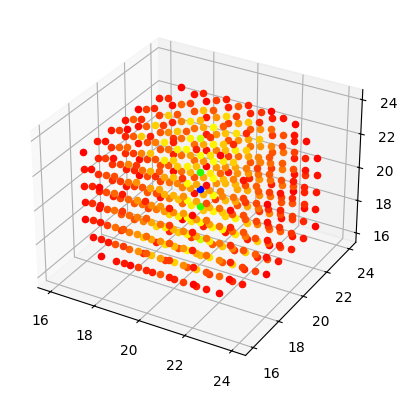

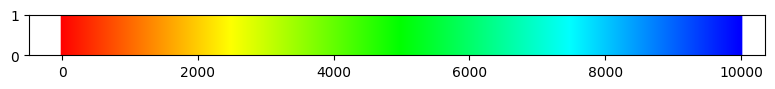

In [410]:
sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])


fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

red = Color("red")
colors = list(red.range_to(Color("blue"), int(list(sorted_dict_duplicates[-1])[-1])+1))

for count, i in enumerate([*dict_duplicates.keys()]):
    x_str, y_str, z_str_ = list(i.split("["))[1].split(" ")
    x, y, z = float(x_str), float(y_str), float(z_str_.split("]")[0])
    ax.scatter(x,y,z, c = str(colors[[*dict_duplicates.values()][count]]))
    
    
#Plot Colormap
x_color = range(int(list(sorted_dict_duplicates[-1])[-1])+1)
dict_colors = dict(zip(x_color,colors))
color_f = lambda n : dict_colors.get(n)

fig1, ax1 = plt.subplots(figsize=(8, 1))

for x_arg in x_color:
    ax1.axvline(x_arg, color=str(color_f(x_arg)))
    
plt.tight_layout()    
plt.show()

In [328]:
arr2 = np.array([4, 5, 6])

arr = np.concatenate((arr, arr2))
print(arr) 

[1 2 3 4 5 6 4 5 6 4 5 6]


In [417]:
from collections import Counter

rounded_lst_Kegel_transposed = np.transpose(rounded_lst_Kegel)
dict_duplicates = dict(Counter(map(tuple, rounded_lst_Kegel_transposed)))
unique_tuples_with_counts = dict_duplicates.items()

In [418]:
unique_tuples_with_counts

dict_items([((24.0, 18.0, 20.0), 176), ((23.0, 19.0, 20.0), 662), ((23.0, 18.0, 22.0), 600), ((23.0, 18.0, 21.0), 747), ((23.0, 18.0, 20.0), 802), ((23.0, 18.0, 19.0), 794), ((23.0, 18.0, 18.0), 609), ((21.0, 19.0, 20.0), 1781), ((22.0, 19.0, 21.0), 1054), ((22.0, 19.0, 20.0), 832), ((22.0, 19.0, 19.0), 1064), ((22.0, 18.0, 22.0), 1242), ((22.0, 18.0, 21.0), 1062), ((22.0, 18.0, 20.0), 1064), ((22.0, 18.0, 19.0), 1132), ((22.0, 18.0, 18.0), 1273), ((20.0, 20.0, 20.0), 10000), ((20.0, 19.0, 21.0), 2469), ((20.0, 19.0, 20.0), 2539), ((20.0, 19.0, 19.0), 2531), ((21.0, 18.0, 22.0), 1663), ((21.0, 18.0, 21.0), 1624), ((21.0, 18.0, 20.0), 1457), ((21.0, 18.0, 19.0), 1634), ((21.0, 18.0, 18.0), 1667), ((21.0, 17.0, 23.0), 532), ((21.0, 17.0, 22.0), 1386), ((21.0, 17.0, 21.0), 1513), ((21.0, 17.0, 20.0), 1301), ((21.0, 17.0, 19.0), 1456), ((21.0, 17.0, 18.0), 1362), ((21.0, 17.0, 17.0), 580), ((19.0, 19.0, 20.0), 1742), ((20.0, 18.0, 21.0), 1778), ((20.0, 18.0, 20.0), 1377), ((20.0, 18.0, 19.

In [419]:

import numpy as np
import matplotlib.pyplot as plt
import math
from colour import Color
from collections import Counter


def koords_in_kegel(x_koord = 0, y_koord = 0, z_koord = 0, alpha = 0, beta = 0 , range_r = 4):
    x = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    y = np.copy(x)
    z = np.copy(x)
    # y = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    # z = np.linspace(-range_r*2, range_r*2, range_r*4+1)

    # Erstelle das Gitter für x, y und z
    x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_grid, y_grid, z_grid)
    # plt.show()
    # ############

    # Mask für innerhalb des Zylinders
    mask = ((z_grid**2 + y_grid**2) <= x_grid**2) & (0 <= x_grid) & (range_r >= x_grid)
    # Filtere Punkte innerhalb des Kegels
    x_mask = x_grid[mask]
    y_mask = y_grid[mask]
    z_mask = z_grid[mask]

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_mask, y_mask, z_mask)
    # plt.show()
    # ###########

    # Rotationsmatrix um die z-Achse
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    rotation_matrix_alpha = np.array([[cos_alpha, -sin_alpha, 0],
                                [sin_alpha, cos_alpha, 0],
                                [0, 0, 1]])


    # Rotationsmatrix um die y-Achse
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    rotation_matrix_beta = np.array([[cos_beta, 0, sin_beta],
                                [0, 1, 0],
                                [-sin_beta, 0, cos_beta]])


    rotation_matrix = np.matmul(rotation_matrix_alpha, rotation_matrix_beta)

    # Wende die Rotationsmatrix auf die x- und y-Koordinaten an
    x_rotated, y_rotated, z_rotated = np.dot(rotation_matrix, np.vstack([x_mask.flatten(), y_mask.flatten(), z_mask.flatten()]))

    # Setze die neuen x- und y-Koordinaten in das Gitter
    x_mask = x_rotated.reshape(x_mask.shape) + x_koord
    y_mask = y_rotated.reshape(y_mask.shape) + y_koord
    z_mask = z_rotated.reshape(z_mask.shape) + z_koord
    return x_mask, y_mask, z_mask



number_of_winkel = 10000
lst_winkel_a = np.arccos(1-2*(np.random.rand(1,number_of_winkel)))
lst_winkel_b = np.random.rand(1,number_of_winkel)*math.pi*2


indizes_des_Kegels_lst = np.array([[],[],[]])
for alpha_w, beta_w in zip(lst_winkel_a[0],lst_winkel_b[0]):
    indizes_des_Kegels_lst =  np.hstack((indizes_des_Kegels_lst, np.array(koords_in_kegel(20, 20, 20, range_r = 3, alpha = alpha_w, beta = beta_w))))
    




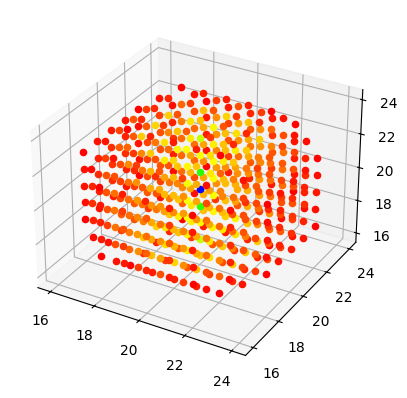

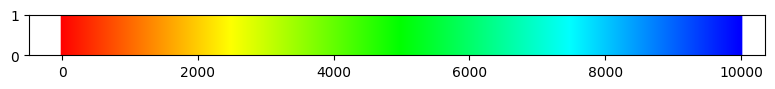

In [434]:

dict_duplicates = dict(Counter(map(tuple, np.transpose(np.rint(indizes_des_Kegels_lst)))))

sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])


fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

red = Color("red")
colors = list(red.range_to(Color("blue"), int(list(sorted_dict_duplicates[-1])[-1])+1))

for count, i in enumerate([*dict_duplicates.keys()]):
    x, y, z = float(i[0]), float(i[1]), float(i[2])
    ax.scatter(x,y,z, c = str(colors[[*dict_duplicates.values()][count]]))
    
    
#Plot Colormap
x_color = range(int(list(sorted_dict_duplicates[-1])[-1])+1)
dict_colors = dict(zip(x_color,colors))
color_f = lambda n : dict_colors.get(n)

fig1, ax1 = plt.subplots(figsize=(8, 1))

for x_arg in x_color:
    ax1.axvline(x_arg, color=str(color_f(x_arg)))
    
plt.tight_layout()    
plt.show()

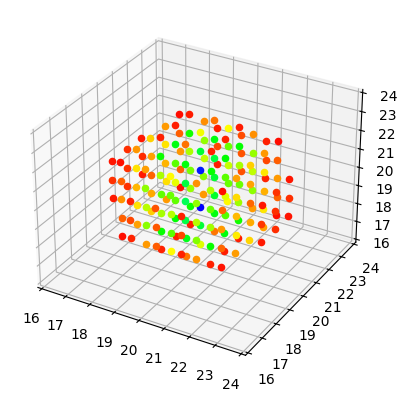

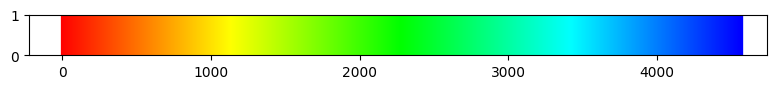

In [435]:

import numpy as np
import matplotlib.pyplot as plt
import math
from colour import Color
from collections import Counter


def koords_in_kegel(x_koord = 0, y_koord = 0, z_koord = 0, alpha = 0, beta = 0 , range_r = 4):
    x = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    y = np.copy(x)
    z = np.copy(x)
    # y = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    # z = np.linspace(-range_r*2, range_r*2, range_r*4+1)

    # Erstelle das Gitter für x, y und z
    x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_grid, y_grid, z_grid)
    # plt.show()
    # ############

    # Mask für innerhalb des Zylinders
    mask = ((z_grid**2 + y_grid**2) <= x_grid**2) & (0 < x_grid) & (range_r >= x_grid)
    # Filtere Punkte innerhalb des Kegels
    x_mask = x_grid[mask]
    y_mask = y_grid[mask]
    z_mask = z_grid[mask]

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_mask, y_mask, z_mask)
    # plt.show()
    # ###########

    # Rotationsmatrix um die z-Achse
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    rotation_matrix_alpha = np.array([[cos_alpha, -sin_alpha, 0],
                                [sin_alpha, cos_alpha, 0],
                                [0, 0, 1]])


    # Rotationsmatrix um die y-Achse
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    rotation_matrix_beta = np.array([[cos_beta, 0, sin_beta],
                                [0, 1, 0],
                                [-sin_beta, 0, cos_beta]])


    rotation_matrix = np.matmul(rotation_matrix_alpha, rotation_matrix_beta)

    # Wende die Rotationsmatrix auf die x- und y-Koordinaten an
    x_rotated, y_rotated, z_rotated = np.dot(rotation_matrix, np.vstack([x_mask.flatten(), y_mask.flatten(), z_mask.flatten()]))

    # Setze die neuen x- und y-Koordinaten in das Gitter
    x_mask = x_rotated.reshape(x_mask.shape) + x_koord
    y_mask = y_rotated.reshape(y_mask.shape) + y_koord
    z_mask = z_rotated.reshape(z_mask.shape) + z_koord
    return x_mask, y_mask, z_mask



number_of_winkel = 10000
lst_winkel_a = np.arccos(1-2*(np.random.rand(1,number_of_winkel)))
lst_winkel_b = np.random.rand(1,number_of_winkel)*math.pi*2


indizes_des_Kegels_lst = np.array([[],[],[]])
for alpha_w, beta_w in zip(lst_winkel_a[0],lst_winkel_b[0]):
    indizes_des_Kegels_lst =  np.hstack((indizes_des_Kegels_lst, np.array(koords_in_kegel(20, 20, 20, range_r = 2, alpha = alpha_w, beta = beta_w))))
    


dict_duplicates = dict(Counter(map(tuple, np.transpose(np.rint(indizes_des_Kegels_lst)))))

sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])


fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

red = Color("red")
colors = list(red.range_to(Color("blue"), int(list(sorted_dict_duplicates[-1])[-1])+1))

for count, i in enumerate([*dict_duplicates.keys()]):
    x, y, z = float(i[0]), float(i[1]), float(i[2])
    ax.scatter(x,y,z, c = str(colors[[*dict_duplicates.values()][count]]))
    
    
#Plot Colormap
x_color = range(int(list(sorted_dict_duplicates[-1])[-1])+1)
dict_colors = dict(zip(x_color,colors))
color_f = lambda n : dict_colors.get(n)

fig1, ax1 = plt.subplots(figsize=(8, 1))

for x_arg in x_color:
    ax1.axvline(x_arg, color=str(color_f(x_arg)))

ax.set_xlim3d(16, 24)
ax.set_ylim3d(16, 24)
ax.set_zlim3d(16, 24)

plt.tight_layout()    
plt.show()


In [1]:
# Die Rotation um die y UND z Achse ist ein Fehler.
# Die Rotation bezieht sich nicht auf das gedrehte Koordinatensystem, sondern auf das Ursprüngliche

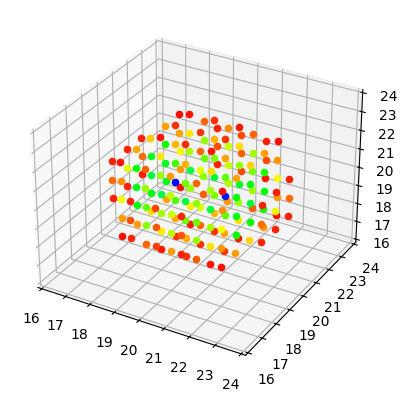

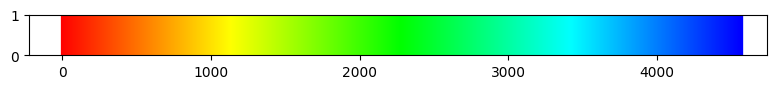

In [2]:

import numpy as np
import matplotlib.pyplot as plt
import math
from colour import Color
from collections import Counter


def koords_in_kegel(x_koord = 0, y_koord = 0, z_koord = 0, range_r = 4, alpha = 0, beta = 0, gamma = 0 ):
    x = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    y = np.copy(x)
    z = np.copy(x)
    # y = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    # z = np.linspace(-range_r*2, range_r*2, range_r*4+1)

    # Erstelle das Gitter für x, y und z
    x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_grid, y_grid, z_grid)
    # plt.show()
    # ############

    # Mask für innerhalb des Zylinders
    mask = ((z_grid**2 + y_grid**2) <= x_grid**2) & (0 < x_grid) & (range_r >= x_grid)
    # Filtere Punkte innerhalb des Kegels
    x_mask = x_grid[mask]
    y_mask = y_grid[mask]
    z_mask = z_grid[mask]

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_mask, y_mask, z_mask)
    # plt.show()
    # ###########

    # Rotationsmatrix um die x-Achse
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    rotation_matrix_alpha = np.array([[1, 0, 0],
                                [0, cos_alpha, -sin_alpha],                               
                                [0, sin_alpha, cos_alpha]])


    # Rotationsmatrix um die y-Achse
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    rotation_matrix_beta = np.array([[cos_beta, 0, sin_beta],
                                [0, 1, 0],
                                [-sin_beta, 0, cos_beta]])
    
    # Rotationsmatrix um die z-Achse
    cos_gamma = np.cos(gamma)
    sin_gamma = np.sin(gamma)
    rotation_matrix_gamma = np.array([[cos_gamma, -sin_gamma, 0],
                                [sin_gamma, cos_gamma, 0],
                                [0, 0, 1]])



    rotation_matrix = np.matmul(rotation_matrix_alpha, rotation_matrix_beta)

    # Wende die Rotationsmatrix auf die x- und y-Koordinaten an
    x_rotated, y_rotated, z_rotated = np.dot(rotation_matrix, np.vstack([x_mask.flatten(), y_mask.flatten(), z_mask.flatten()]))

    # Setze die neuen x- und y-Koordinaten in das Gitter
    x_mask = x_rotated.reshape(x_mask.shape) + x_koord
    y_mask = y_rotated.reshape(y_mask.shape) + y_koord
    z_mask = z_rotated.reshape(z_mask.shape) + z_koord
    return x_mask, y_mask, z_mask



number_of_winkel = 10000
lst_winkel_a = np.arccos(1-2*(np.random.rand(1,number_of_winkel)))
lst_winkel_b = np.random.rand(1,number_of_winkel)*math.pi*2


indizes_des_Kegels_lst = np.array([[],[],[]])
for alpha_w, beta_w in zip(lst_winkel_a[0],lst_winkel_b[0]):
    indizes_des_Kegels_lst =  np.hstack((indizes_des_Kegels_lst, np.array(koords_in_kegel(20, 20, 20, range_r = 2, alpha = alpha_w, beta = beta_w))))
    


dict_duplicates = dict(Counter(map(tuple, np.transpose(np.rint(indizes_des_Kegels_lst)))))

sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])


fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

red = Color("red")
colors = list(red.range_to(Color("blue"), int(list(sorted_dict_duplicates[-1])[-1])+1))

for count, i in enumerate([*dict_duplicates.keys()]):
    x, y, z = float(i[0]), float(i[1]), float(i[2])
    ax.scatter(x,y,z, c = str(colors[[*dict_duplicates.values()][count]]))
    
    
#Plot Colormap
x_color = range(int(list(sorted_dict_duplicates[-1])[-1])+1)
dict_colors = dict(zip(x_color,colors))
color_f = lambda n : dict_colors.get(n)

fig1, ax1 = plt.subplots(figsize=(8, 1))

for x_arg in x_color:
    ax1.axvline(x_arg, color=str(color_f(x_arg)))

ax.set_xlim3d(16, 24)
ax.set_ylim3d(16, 24)
ax.set_zlim3d(16, 24)

plt.tight_layout()    
plt.show()


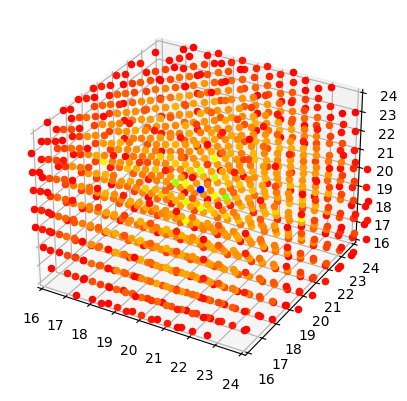

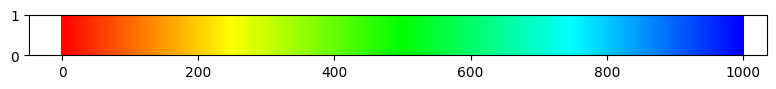

In [3]:

import numpy as np
import matplotlib.pyplot as plt
import math
from colour import Color
from collections import Counter


def koords_in_kegel(x_koord = 0, y_koord = 0, z_koord = 0, range_r = 4, alpha = 0, beta = 0, gamma = 0 ):
    x = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    y = np.copy(x)
    z = np.copy(x)
    # y = np.linspace(-range_r*2, range_r*2, range_r*4+1)
    # z = np.linspace(-range_r*2, range_r*2, range_r*4+1)

    # Erstelle das Gitter für x, y und z
    x_grid, y_grid, z_grid = np.meshgrid(x, y, z)

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_grid, y_grid, z_grid)
    # plt.show()
    # ############

    # Mask für innerhalb des Zylinders
    mask = ((z_grid**2 + y_grid**2) <= x_grid**2) & (0 <= x_grid) & (range_r >= x_grid)
    # Filtere Punkte innerhalb des Kegels
    x_mask = x_grid[mask]
    y_mask = y_grid[mask]
    z_mask = z_grid[mask]

    # ############ Scatter Plot
    # fig = plt.figure()
    # ax = plt.axes(projection='3d')
    # ax.scatter(x_mask, y_mask, z_mask)
    # plt.show()
    # ###########

    # Rotationsmatrix um die x-Achse
    cos_alpha = np.cos(alpha)
    sin_alpha = np.sin(alpha)
    rotation_matrix_alpha = np.array([[1, 0, 0],
                                [0, cos_alpha, -sin_alpha],                               
                                [0, sin_alpha, cos_alpha]])


    # Rotationsmatrix um die y-Achse
    cos_beta = np.cos(beta)
    sin_beta = np.sin(beta)
    rotation_matrix_beta = np.array([[cos_beta, 0, sin_beta],
                                [0, 1, 0],
                                [-sin_beta, 0, cos_beta]])
    
    
    # Rotationsmatrix um die z-Achse
    cos_gamma = np.cos(gamma)
    sin_gamma = np.sin(gamma)
    rotation_matrix_gamma = np.array([[cos_gamma, -sin_gamma, 0],
                                [sin_gamma, cos_gamma, 0],
                                [0, 0, 1]])



    rotation_matrix = np.matmul(rotation_matrix_alpha, rotation_matrix_beta)

    # Wende die Rotationsmatrix auf die x- und y-Koordinaten an
    x_rotated, y_rotated, z_rotated = np.dot(rotation_matrix, np.vstack([x_mask.flatten(), y_mask.flatten(), z_mask.flatten()]))

    # Setze die neuen x- und y-Koordinaten in das Gitter
    x_mask = x_rotated.reshape(x_mask.shape) + x_koord
    y_mask = y_rotated.reshape(y_mask.shape) + y_koord
    z_mask = z_rotated.reshape(z_mask.shape) + z_koord
    return x_mask, y_mask, z_mask



number_of_winkel = 1000
lst_winkel_b = np.arccos(1-2*(np.random.rand(1,number_of_winkel)))
lst_winkel_a = np.random.rand(1,number_of_winkel)*math.pi*2



indizes_des_Kegels_lst = np.array([[],[],[]])
for alpha_w, beta_w in zip(lst_winkel_a[0],lst_winkel_b[0]):
    indizes_des_Kegels_lst =  np.hstack((indizes_des_Kegels_lst, np.array(koords_in_kegel(20, 20, 20, range_r = 4, alpha = alpha_w, beta = beta_w))))
    


dict_duplicates = dict(Counter(map(tuple, np.transpose(np.rint(indizes_des_Kegels_lst)))))

sorted_dict_duplicates = sorted(dict_duplicates.items(), key = lambda x:x[1])


fig = plt.figure()
ax = fig.add_subplot(projection = "3d")

red = Color("red")
colors = list(red.range_to(Color("blue"), int(list(sorted_dict_duplicates[-1])[-1])+1))

for count, i in enumerate([*dict_duplicates.keys()]):
    x, y, z = float(i[0]), float(i[1]), float(i[2])
    ax.scatter(x,y,z, c = str(colors[[*dict_duplicates.values()][count]]))
    
    
#Plot Colormap
x_color = range(int(list(sorted_dict_duplicates[-1])[-1])+1)
dict_colors = dict(zip(x_color,colors))
color_f = lambda n : dict_colors.get(n)

fig1, ax1 = plt.subplots(figsize=(8, 1))

for x_arg in x_color:
    ax1.axvline(x_arg, color=str(color_f(x_arg)))

ax.set_xlim3d(16, 24)
ax.set_ylim3d(16, 24)
ax.set_zlim3d(16, 24)

plt.tight_layout()    
plt.show()


In [4]:
# Problem bis auf 2 Punkte gelöst?
# die 2 Grünen Punkte